### Import libraries

In [9]:
import pip
! python -m pip install /Users/sienkadounia/lab/ai-futures/Project/devinterp
import torch
import numpy as np
import seaborn
import yaml
import devinterp
import torch.nn as nn
import torchvision
import pandas as pd
import matplotlib.pyplot as plt
import copy
from torch import optim
from tqdm import tqdm
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Dataset

from devinterp.slt import estimate_learning_coeff, estimate_learning_coeff_with_summary
from devinterp.slt import llc

from devinterp.slt.mala import MalaAcceptanceRate
from devinterp.optim.sgld import SGLD
from devinterp.utils import plot_trace, optimal_temperature

Processing /Users/sienkadounia/lab/ai-futures/Project/devinterp
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for devinterp: filename=devinterp-0.1.0-py3-none-any.whl size=28696 sha256=a38b6947c78d088130583536a82fc42cd9ec6a831419f4727391ec164a8ad642
  Stored in directory: /private/var/folders/z1/4ncpvz_901x1gm_4cv8jlcwr0000gn/T/pip-ephem-wheel-cache-z1cvrgpj/wheels/d1/77/c6/79d956127053bf417b2be69c96cf13206452a78ec4d772f07c
Successfully built devinterp
  Attempting uninstall: devinterp
    Found existing installation: devinterp 0.1.0
    Uninstalling devinterp-0.1.0:
      Successfully uninstalled devinterp-0.1.0


In [132]:
if not torch.backends.mps.is_available():
    if not torch.backends.mps.is_built():
        print("MPS not available because the current PyTorch install was not "
              "built with MPS enabled.")
    else:
        print("MPS not available because the current MacOS version is not 12.3+ "
              "and/or you do not have an MPS-enabled device on this machine.")

else:
    mps_device = torch.device("mps")

device = 'mps' # 'cuda' if torch.cuda.is_available() else 'cpu'

In [133]:
# Let's define all the hyperparameters
on_colab = False
batch_size = 500
epochs = 1000
model_seed = 42
data_seed = 42

In [134]:
checkpoints_path = '/Users/sienkadounia/lab/ai-futures/Project/ewdd/'
label_noise_path = '/Users/sienkadounia/lab/ai-futures/Project/label_noise/'
rlcts_path = '/Users/sienkadounia/lab/checkpoints/rlcts/ewdd/'

### Get the dataset

In [135]:
class MyDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        x = self.X[idx]
        y = self.y[idx]
        return x, y

In [136]:
train_dataset = torch.load('/Users/sienkadounia/lab/ai-futures/Project/ewdd/dln_train_dataset.pt')
test_dataset = torch.load('/Users/sienkadounia/lab/ai-futures/Project/ewdd/dln_test_dataset.pt')

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [137]:
input_size = train_loader.dataset.X.shape[-1]

### Model

In [138]:
# Define the neural network model
class RidgeRegressionNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(RidgeRegressionNN, self).__init__()
        self.linear1 = nn.Linear(input_size, hidden_size, bias=False)
        self.linear2 = nn.Linear(hidden_size, output_size, bias=False)

    def forward(self, x):
        x = self.linear1(x)
        x = self.linear2(x)
        return x

In [139]:
hidden_layer_sizes = list(range(0, 200, 20))
models = []

for hidden_layer_size in hidden_layer_sizes:
    model = model = RidgeRegressionNN(input_size=input_size,
    hidden_size = input_size + hidden_layer_size,
    output_size=input_size)
    state_dict = torch.load(checkpoints_path + 'dln'+ str(hidden_layer_size)+ '_checkpoint' + '999' +'.pth', map_location=device)


    model.load_state_dict(state_dict)
    models.append(model)

In [140]:
import math
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

def lr_lambda(epoch):
    base_lr = 0.1
    return base_lr/math.sqrt(epoch+1)

### MALA Calibration

In [141]:
EPSILONS = [1e-3, 1e-4, 1e-5, 1e-6, 1e-7, 1e-8]
GAMMAS = [1.0, 10.0, 100.0]
NUM_CHAINS = 1
NUM_DRAWS = 500
all_calib_results = []

for i in range(len(hidden_layer_sizes)):
    model = models[i]
    trainloader = train_loader
    criterion = nn.MSELoss()
    calib_results = {}
    print(f'Running MALA calibration for DLN Model with {count_parameters(model)} parameters')


    def estimate_mala_sweeper(model):
        for epsilon in EPSILONS:
            for gamma in GAMMAS:
                mala_estimator = MalaAcceptanceRate(
                    num_chains=NUM_CHAINS,
                    num_draws=NUM_DRAWS,
                    temperature=optimal_temperature(trainloader),
                    learning_rate=epsilon,
                    device=device,
                )

                result = estimate_learning_coeff_with_summary(
                    model,
                    trainloader,
                    criterion=criterion,
                    optimizer_kwargs=dict(
                        lr=epsilon, localization=gamma, temperature=optimal_temperature(trainloader)
                    ),
                    sampling_method=SGLD,
                    num_chains=NUM_CHAINS,
                    num_draws=NUM_DRAWS,
                    callbacks=[mala_estimator],
                    verbose=False,
                    online=True,
                )
                mala_acceptance_rate_mean = mala_estimator.sample()["mala_accept/mean"]
                calib_results[(epsilon, gamma)] = result
                print(
                    f"epsilon {epsilon}, gamma {gamma}, mala rate: {mala_acceptance_rate_mean}"
                )

    estimate_mala_sweeper(model)
    all_calib_results.append(calib_results)

torch.save(all_calib_results, rlcts_path + 'all_calib_results.pt')

Running MALA calibration for DLN Model with 50 parameters
epsilon 0.001, gamma 1.0, mala rate: nan


/Users/sienkadounia/anaconda3/envs/new/lib/python3.9/site-packages/devinterp/slt/sampler.py:146: UserWarning: You are taking more draws than burn-in steps, your LLC estimates will likely be underestimates. Please check LLC chain convergence.
  warnings.warn(
/Users/sienkadounia/anaconda3/envs/new/lib/python3.9/site-packages/devinterp/slt/sampler.py:150: UserWarning: You are taking more sample batches than there are dataloader batches available, this removes some randomness from sampling but is probably fine. (All sample batches beyond the number dataloader batches are cycled from the start, f.e. 9 samples from [A, B, C] would be [B, A, C, B, A, C, B, A, C].)
  warnings.warn(
/Users/sienkadounia/anaconda3/envs/new/lib/python3.9/site-packages/devinterp/slt/sampler.py:58: UserWarning: You are taking more sample batches than there are dataloader batches available, this removes some randomness from sampling but is probably fine. (All sample batches beyond the number dataloader batches are c

epsilon 0.001, gamma 10.0, mala rate: nan
epsilon 0.001, gamma 100.0, mala rate: nan
epsilon 0.0001, gamma 1.0, mala rate: 0.6358234286308289
epsilon 0.0001, gamma 10.0, mala rate: 0.6470892429351807
epsilon 0.0001, gamma 100.0, mala rate: 0.6200388669967651
epsilon 1e-05, gamma 1.0, mala rate: 0.7818710207939148
epsilon 1e-05, gamma 10.0, mala rate: 0.7660340070724487
epsilon 1e-05, gamma 100.0, mala rate: 0.7870969176292419
epsilon 1e-06, gamma 1.0, mala rate: 0.8522722721099854
epsilon 1e-06, gamma 10.0, mala rate: 0.9273515343666077
epsilon 1e-06, gamma 100.0, mala rate: 0.8166525959968567
epsilon 1e-07, gamma 1.0, mala rate: 0.9591951370239258
epsilon 1e-07, gamma 10.0, mala rate: 0.9683724641799927
epsilon 1e-07, gamma 100.0, mala rate: 0.9416759014129639
epsilon 1e-08, gamma 1.0, mala rate: 0.9928748607635498
epsilon 1e-08, gamma 10.0, mala rate: 0.9923685789108276
epsilon 1e-08, gamma 100.0, mala rate: 0.9956739544868469
Running MALA calibration for DLN Model with 250 parameter

In [142]:
def plot_single_graph(result, title="MALA Calibration for DLN with 2 layers"):
    llc_color = "teal"
    fig, axs = plt.subplots(1, 1)
    # plot loss traces
    loss_traces = result["loss/trace"]
    for trace in loss_traces:
        init_loss = trace[0]
        zeroed_trace = trace - init_loss
        sgld_steps = list(range(len(trace)))
        axs.plot(sgld_steps, zeroed_trace)

    # plot llcs
    means = result["llc/means"]
    stds = result["llc/stds"]
    sgld_steps = list(range(len(means)))
    axs2 = axs.twinx()
    axs2.plot(
        sgld_steps,
        means,
        color=llc_color,
        linestyle="--",
        linewidth=2,
        label=f"llc",
        zorder=3,
    )
    axs2.fill_between(
        sgld_steps, means - stds, means + stds, color=llc_color, alpha=0.3, zorder=2
    )

    # center zero, assume zero is in the range of both y axes already
    y1_min, y1_max = axs.get_ylim()
    y2_min, y2_max = axs2.get_ylim()
    y1_zero_ratio = abs(y1_min) / (abs(y1_min) + abs(y1_max))
    y2_zero_ratio = abs(y2_min) / (abs(y2_min) + abs(y2_max))
    percent_to_add = abs(y1_zero_ratio - y2_zero_ratio)
    y1_amt_to_add = (y1_max - y1_min) * percent_to_add
    y2_amt_to_add = (y2_max - y2_min) * percent_to_add
    if y1_zero_ratio < y2_zero_ratio:
        # add to bottom of y1 and top of y2
        y1_min -= y1_amt_to_add
        y2_max += y2_amt_to_add
    elif y2_zero_ratio < y1_zero_ratio:
        # add to bottom of y2 and top of y1
        y2_min -= y2_amt_to_add
        y1_max += y1_amt_to_add
    axs.set_ylim(y1_min, y1_max)
    axs2.set_ylim(y2_min, y2_max)
    axs.set_xlabel("SGLD time step")
    axs.set_ylabel("loss")
    axs2.set_ylabel("llc", color=llc_color)
    axs2.tick_params(axis="y", labelcolor=llc_color)
    axs.axhline(color="black", linestyle=":")
    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()


def plot_sweep_single_model(results, epsilons, gammas, **kwargs):
    llc_color = "teal"
    fig, axs = plt.subplots(len(epsilons), len(gammas))

    for i, epsilon in enumerate(epsilons):
        for j, gamma in enumerate(gammas):
            result = results[(epsilon, gamma)]
            # plot loss traces
            loss_traces = result["loss/trace"]
            for trace in loss_traces:
                init_loss = trace[0]
                zeroed_trace = trace - init_loss
                sgld_steps = list(range(len(trace)))
                axs[i, j].plot(sgld_steps, zeroed_trace)

            # plot llcs
            means = result["llc/means"]
            stds = result["llc/stds"]
            sgld_steps = list(range(len(means)))
            axs2 = axs[i, j].twinx()
            axs2.plot(
                sgld_steps,
                means,
                color=llc_color,
                linestyle="--",
                linewidth=2,
                label=f"llc",
                zorder=3,
            )
            axs2.fill_between(
                sgld_steps,
                means - stds,
                means + stds,
                color=llc_color,
                alpha=0.3,
                zorder=2,
            )

            # center zero, assume zero is in the range of both y axes already
            y1_min, y1_max = axs[i, j].get_ylim()
            y2_min, y2_max = axs2.get_ylim()
            y1_zero_ratio = abs(y1_min) / (abs(y1_min) + abs(y1_max))
            y2_zero_ratio = abs(y2_min) / (abs(y2_min) + abs(y2_max))
            percent_to_add = abs(y1_zero_ratio - y2_zero_ratio)
            y1_amt_to_add = (y1_max - y1_min) * percent_to_add
            y2_amt_to_add = (y2_max - y2_min) * percent_to_add
            if y1_zero_ratio < y2_zero_ratio:
                # add to bottom of y1 and top of y2
                y1_min -= y1_amt_to_add
                y2_max += y2_amt_to_add
            elif y2_zero_ratio < y1_zero_ratio:
                # add to bottom of y2 and top of y1
                y2_min -= y2_amt_to_add
                y1_max += y1_amt_to_add
            axs[i, j].set_ylim(y1_min, y1_max)
            axs2.set_ylim(y2_min, y2_max)

            axs[i, j].set_title(f"$\epsilon$ = {epsilon} : $\gamma$ = {gamma}")
            # only show x axis label on last row
            if i == len(epsilons) - 1:
                axs[i, j].set_xlabel("SGLD time step")
            axs[i, j].set_ylabel("loss")
            axs2.set_ylabel("llc", color=llc_color)
            axs2.tick_params(axis="y", labelcolor=llc_color)
    if kwargs["title"]:
        fig.suptitle(kwargs["title"], fontsize=16)
    plt.tight_layout()
    plt.show()

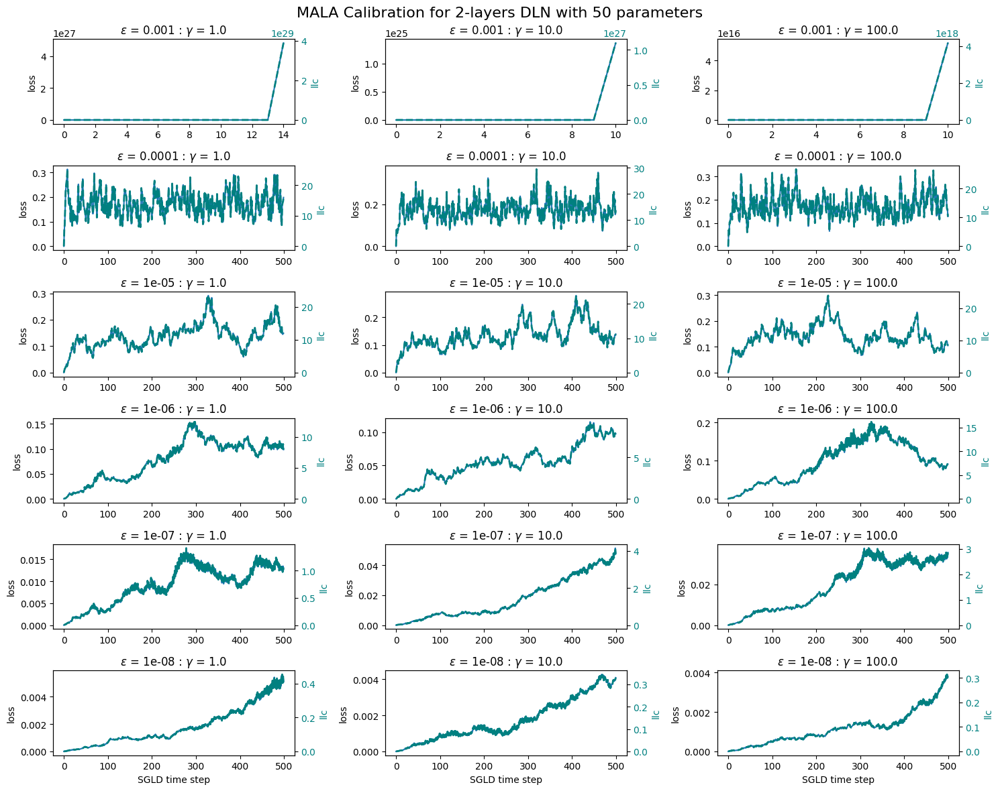

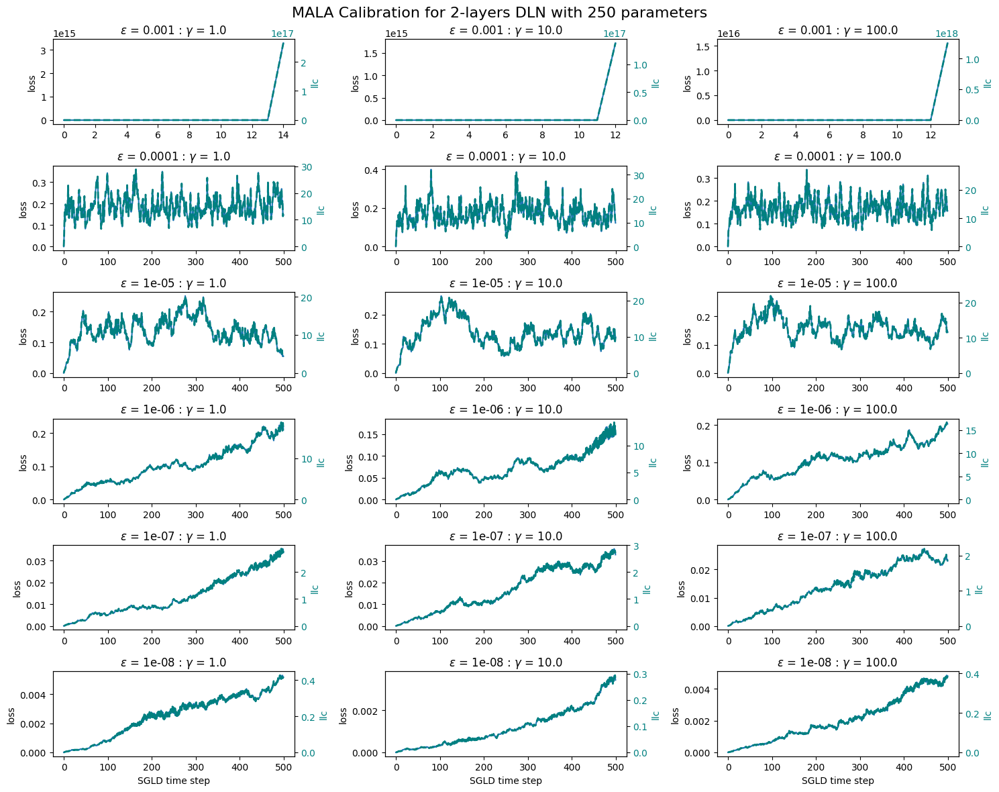

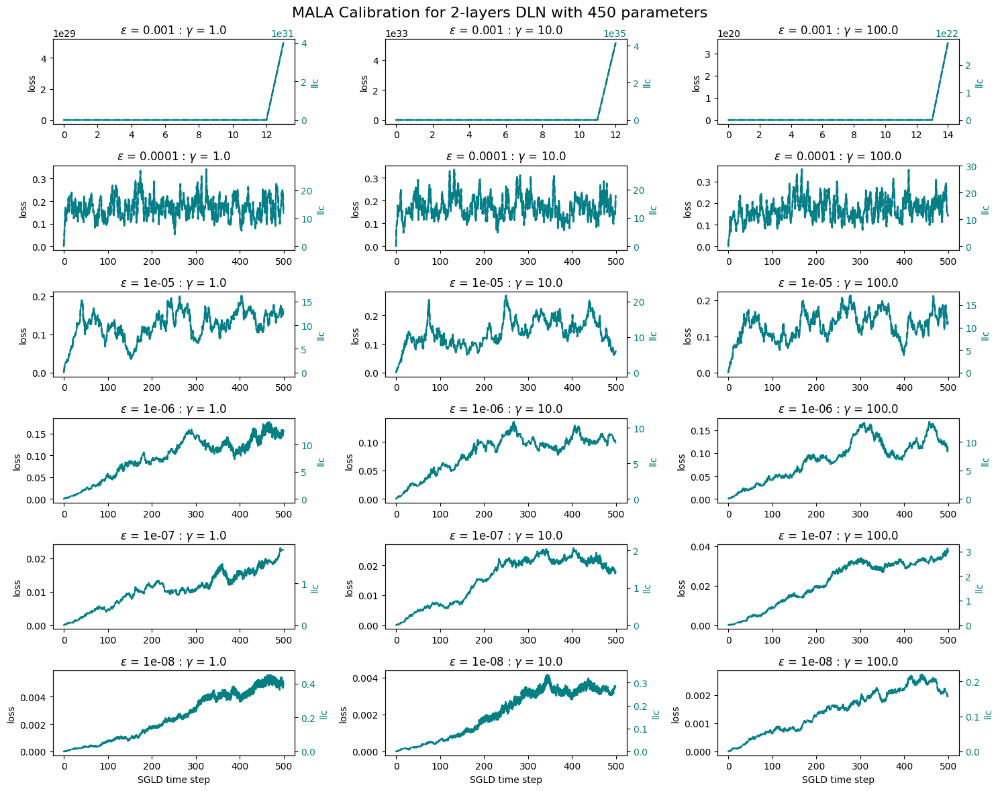

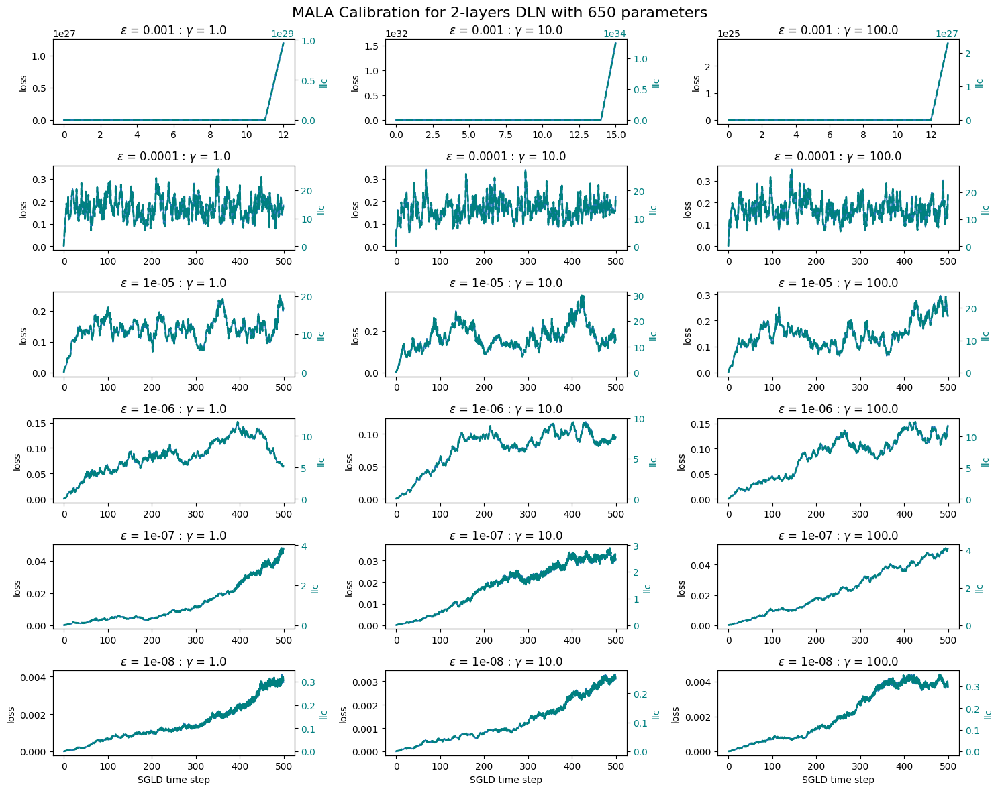

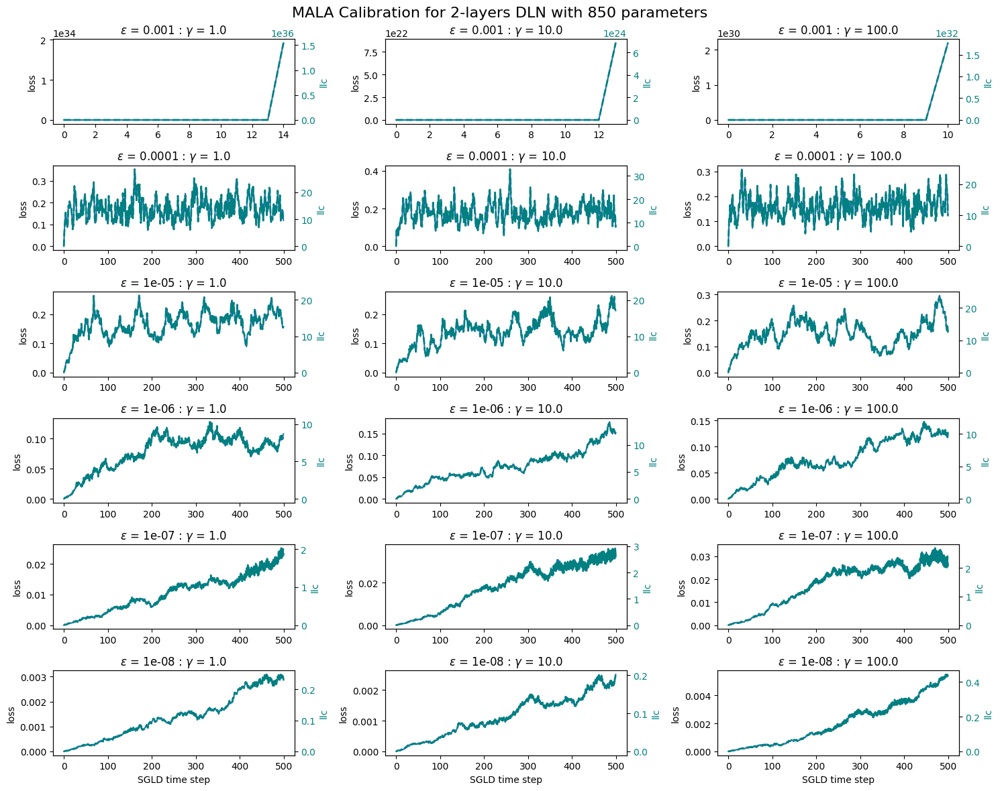

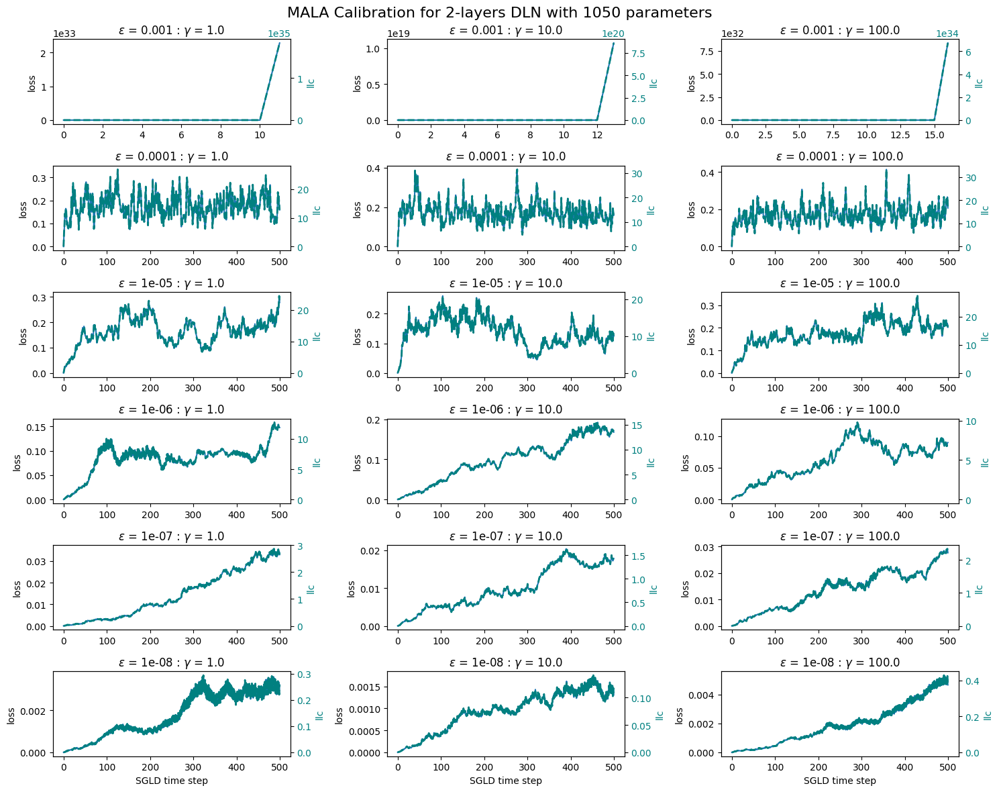

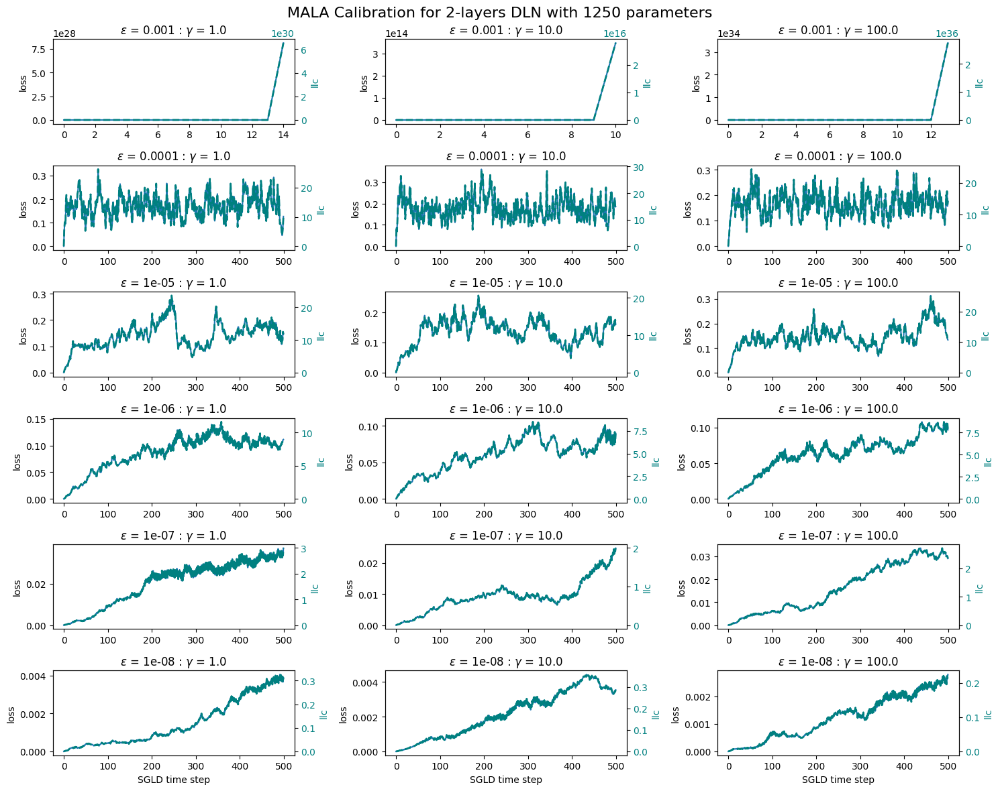

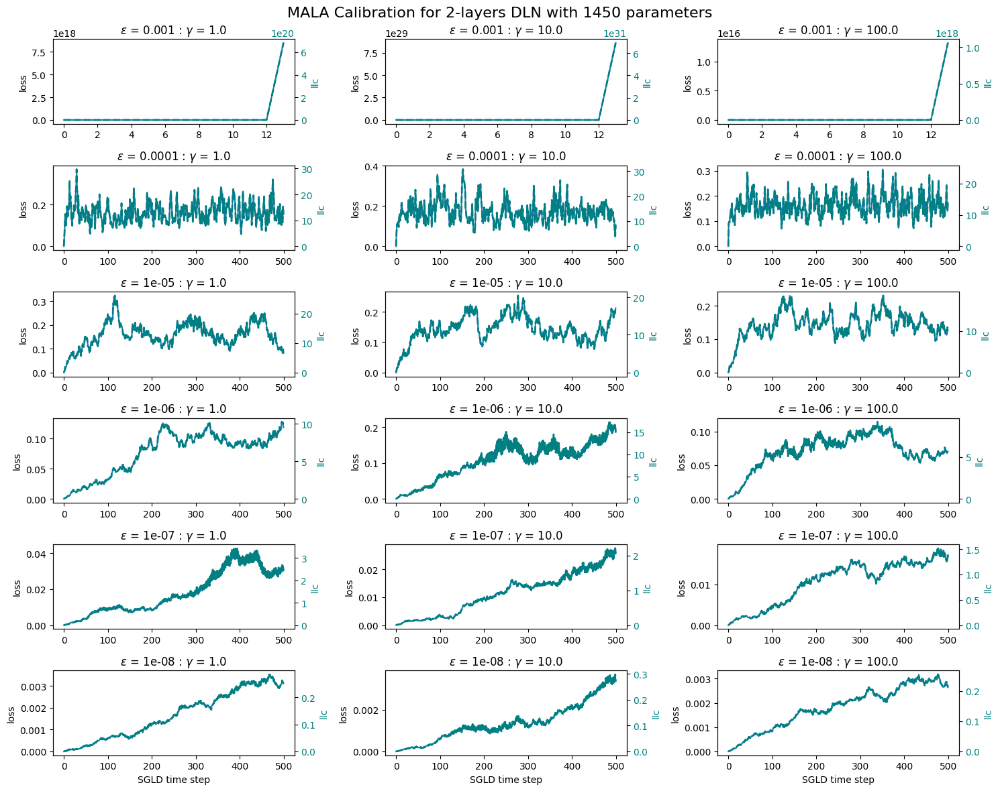

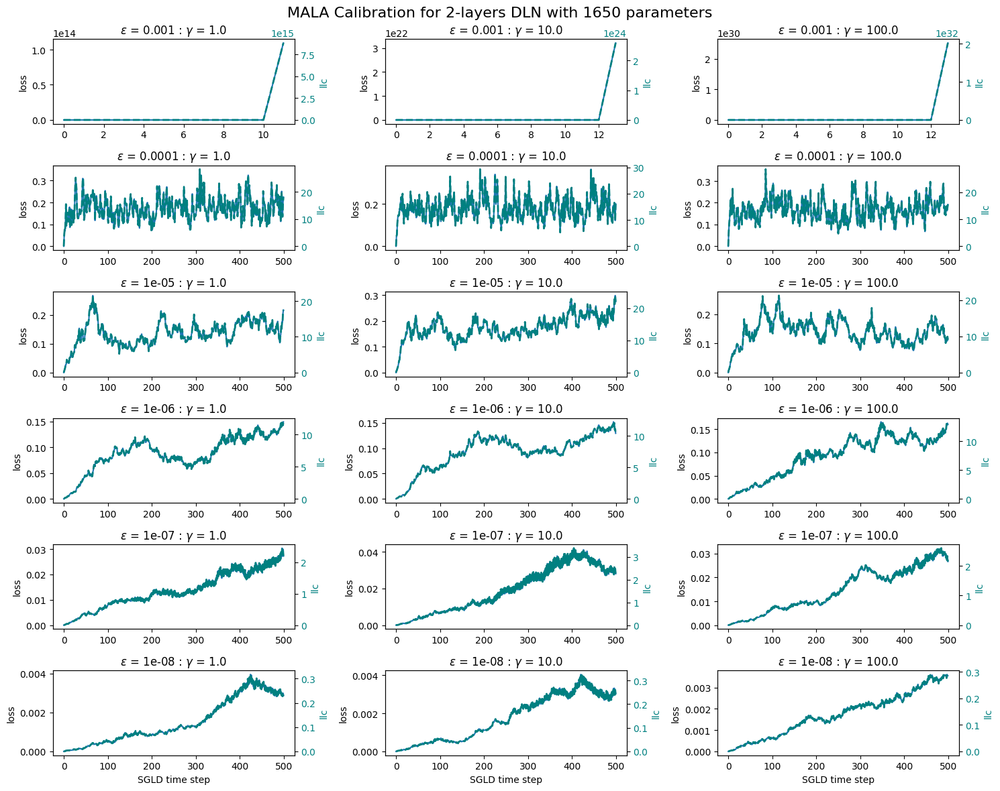

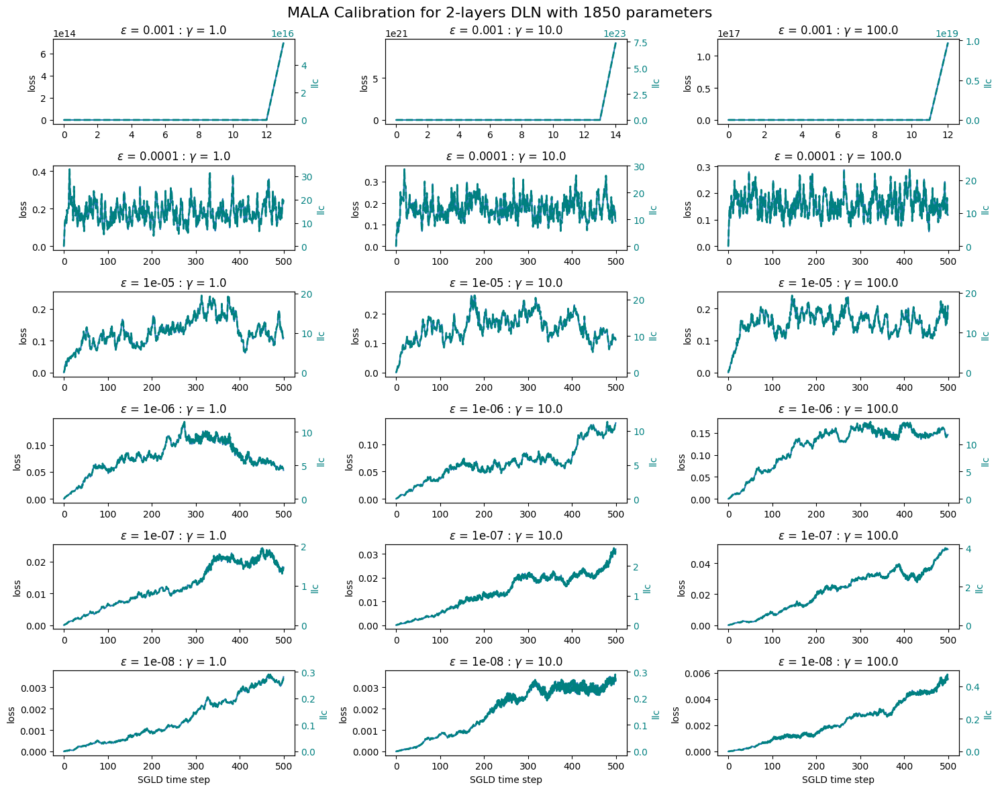

In [143]:
plt.rcParams["figure.figsize"] = (
    15,
    12,
)  # note: this cell may need to be re-run after creating a plot to take effect
for i in range(len(all_calib_results)):
    results = all_calib_results[i]
    plot_sweep_single_model(results, EPSILONS, GAMMAS, title=f"MALA Calibration for 2-layers DLN with {count_parameters(models[i])} parameters")

### More draws

In [144]:
EPSILONS = [1e-3, 1e-4, 1e-5, 1e-6, 1e-7, 1e-8]
GAMMAS = [1.0, 10.0, 100.0]
NUM_CHAINS = 1
NUM_DRAWS = 1000
all_calib_results = []

for i in range(len(hidden_layer_sizes)):
    model = models[i]
    trainloader = train_loader
    criterion = nn.MSELoss()
    calib_results = {}
    print(f'Running MALA calibration for DLN Model with {count_parameters(model)} parameters')


    def estimate_mala_sweeper(model):
        for epsilon in EPSILONS:
            for gamma in GAMMAS:
                mala_estimator = MalaAcceptanceRate(
                    num_chains=NUM_CHAINS,
                    num_draws=NUM_DRAWS,
                    temperature=optimal_temperature(trainloader),
                    learning_rate=epsilon,
                    device=device,
                )

                result = estimate_learning_coeff_with_summary(
                    model,
                    trainloader,
                    criterion=criterion,
                    optimizer_kwargs=dict(
                        lr=epsilon, localization=gamma, temperature=optimal_temperature(trainloader)
                    ),
                    sampling_method=SGLD,
                    num_chains=NUM_CHAINS,
                    num_draws=NUM_DRAWS,
                    callbacks=[mala_estimator],
                    verbose=False,
                    online=True,
                )
                mala_acceptance_rate_mean = mala_estimator.sample()["mala_accept/mean"]
                calib_results[(epsilon, gamma)] = result
                print(
                    f"epsilon {epsilon}, gamma {gamma}, mala rate: {mala_acceptance_rate_mean}"
                )

    estimate_mala_sweeper(model)
    all_calib_results.append(calib_results)

torch.save(all_calib_results, rlcts_path + 'mdraws_all_calib_results.pt')

Running MALA calibration for DLN Model with 50 parameters
epsilon 0.001, gamma 1.0, mala rate: nan
epsilon 0.001, gamma 10.0, mala rate: nan
epsilon 0.001, gamma 100.0, mala rate: nan
epsilon 0.0001, gamma 1.0, mala rate: 0.6357254385948181
epsilon 0.0001, gamma 10.0, mala rate: 0.6373192071914673
epsilon 0.0001, gamma 100.0, mala rate: 0.6310977935791016
epsilon 1e-05, gamma 1.0, mala rate: 0.7862852811813354
epsilon 1e-05, gamma 10.0, mala rate: 0.7703953981399536
epsilon 1e-05, gamma 100.0, mala rate: 0.7488346695899963
epsilon 1e-06, gamma 1.0, mala rate: 0.8671931624412537
epsilon 1e-06, gamma 10.0, mala rate: 0.8076189160346985
epsilon 1e-06, gamma 100.0, mala rate: 0.7919213175773621
epsilon 1e-07, gamma 1.0, mala rate: 0.9560016393661499
epsilon 1e-07, gamma 10.0, mala rate: 0.9433565735816956
epsilon 1e-07, gamma 100.0, mala rate: 0.9303114414215088
epsilon 1e-08, gamma 1.0, mala rate: 0.9954546689987183
epsilon 1e-08, gamma 10.0, mala rate: 0.9934003949165344
epsilon 1e-08, g

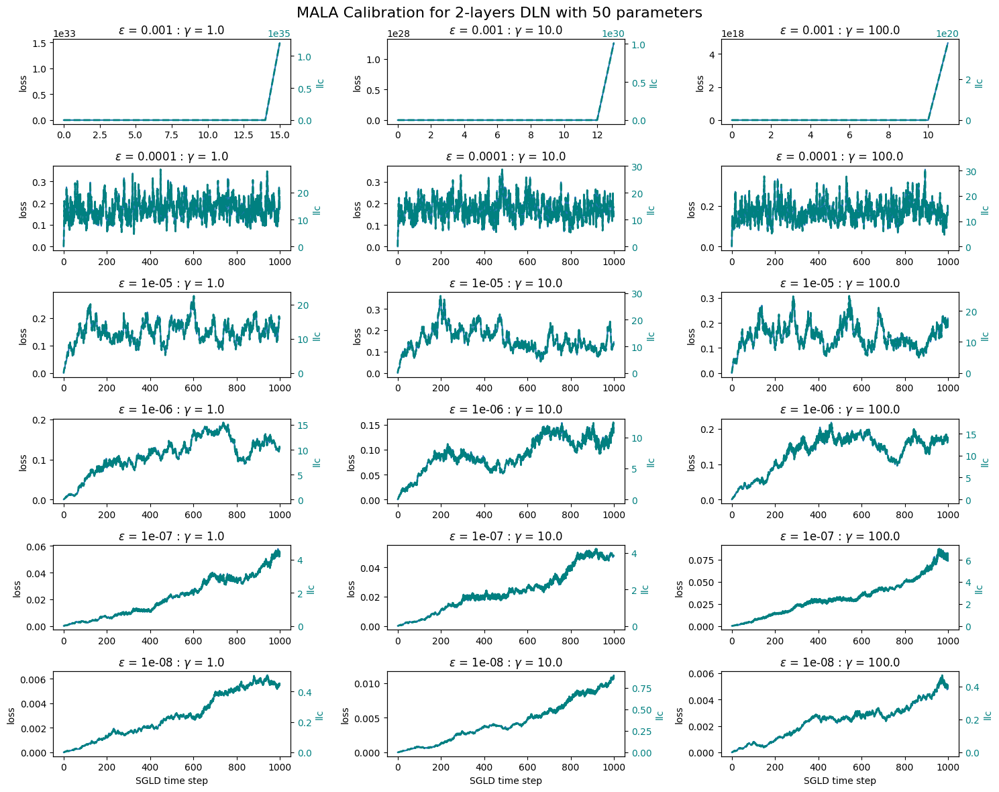

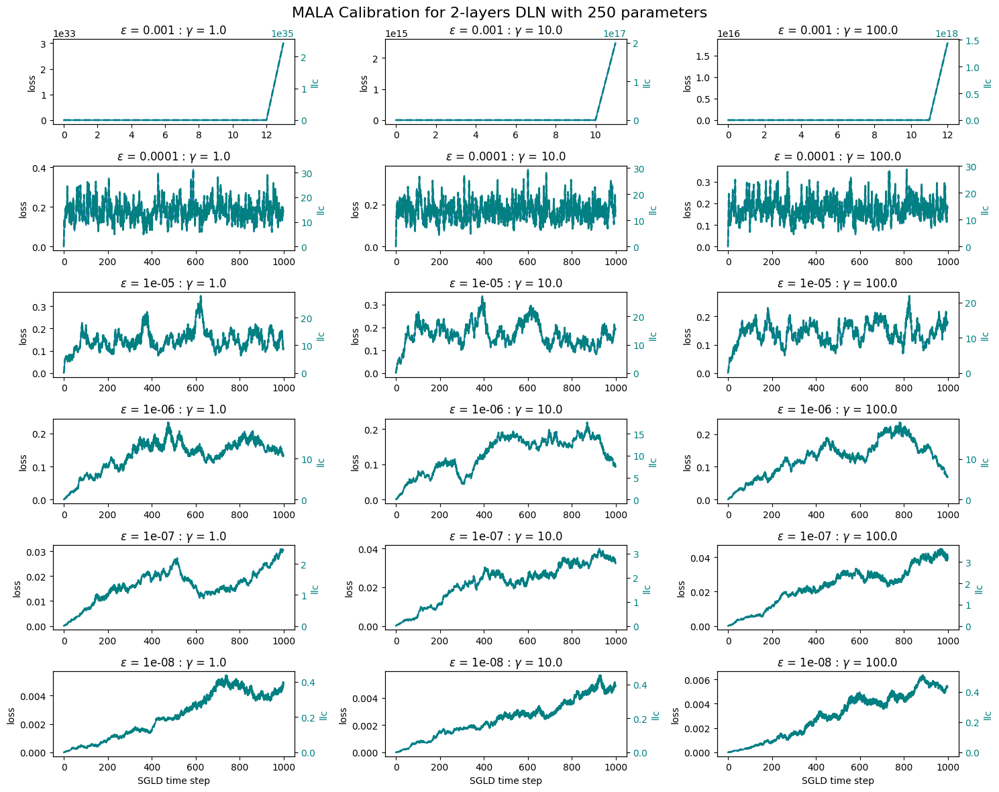

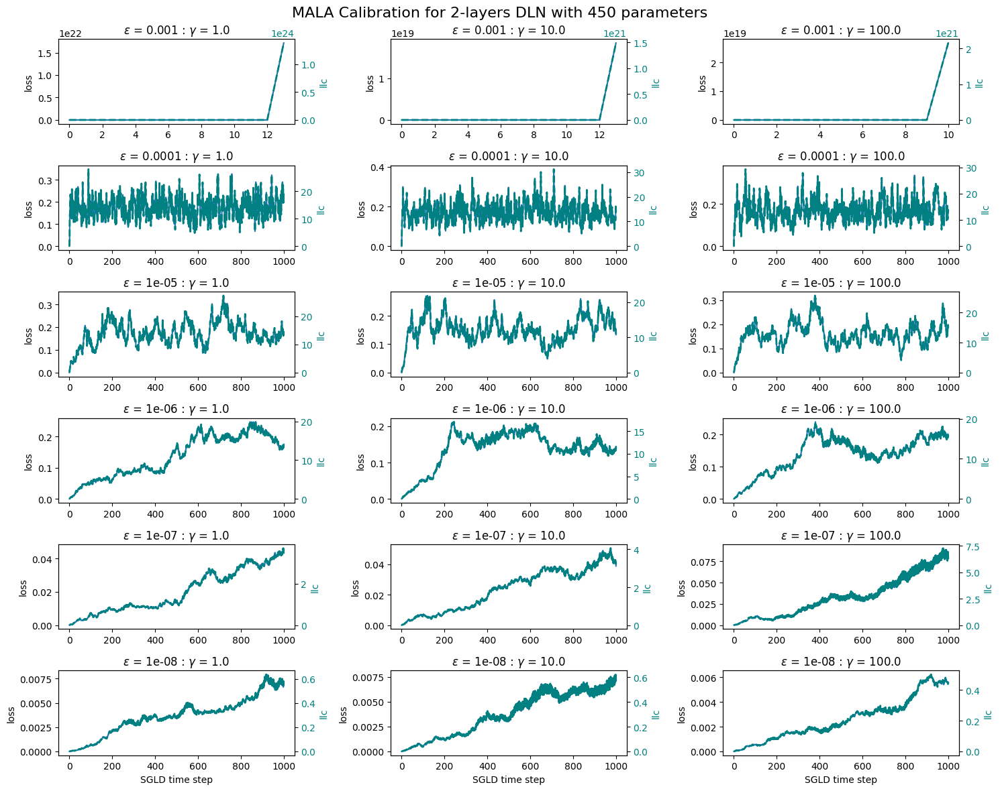

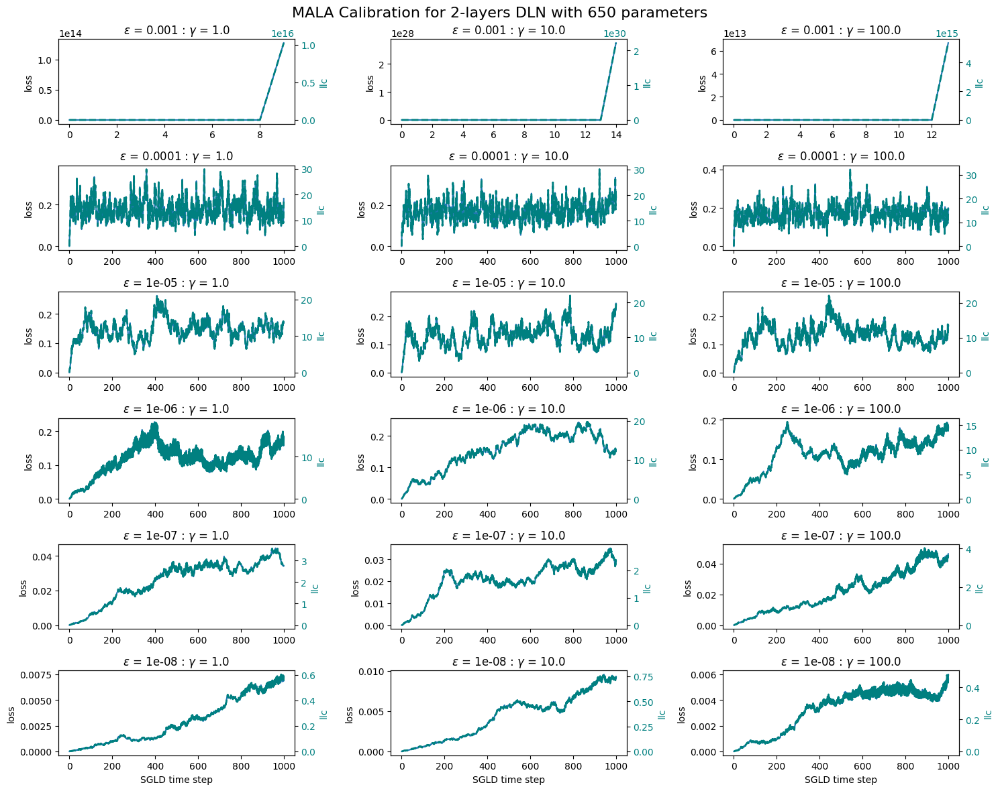

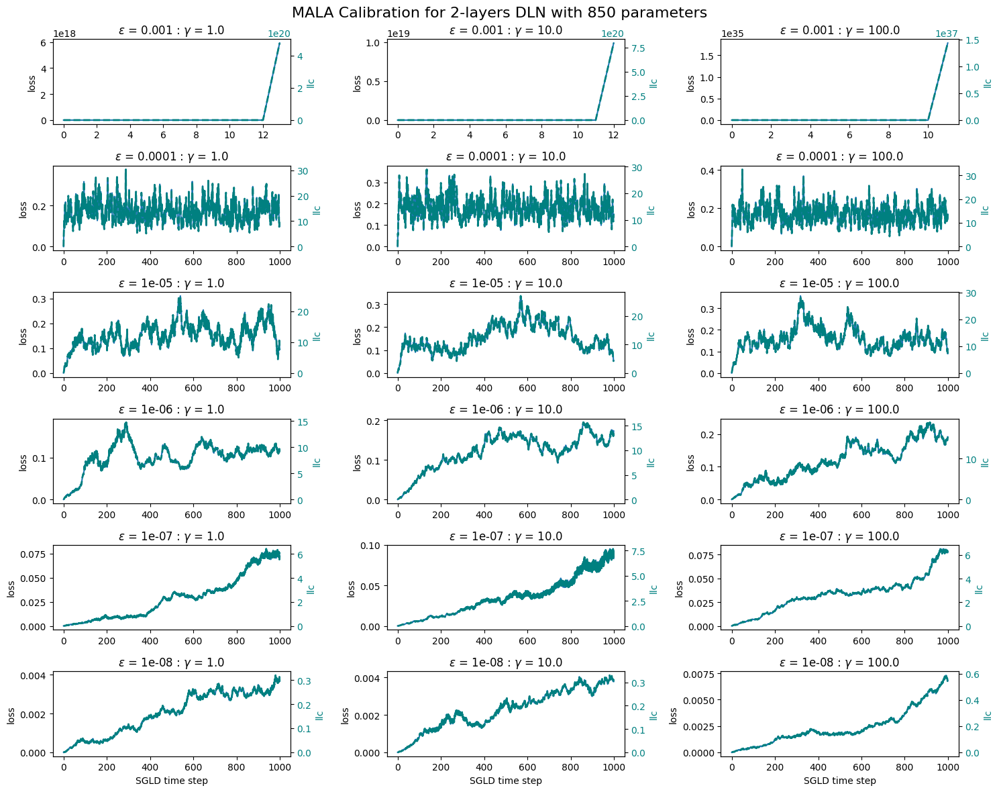

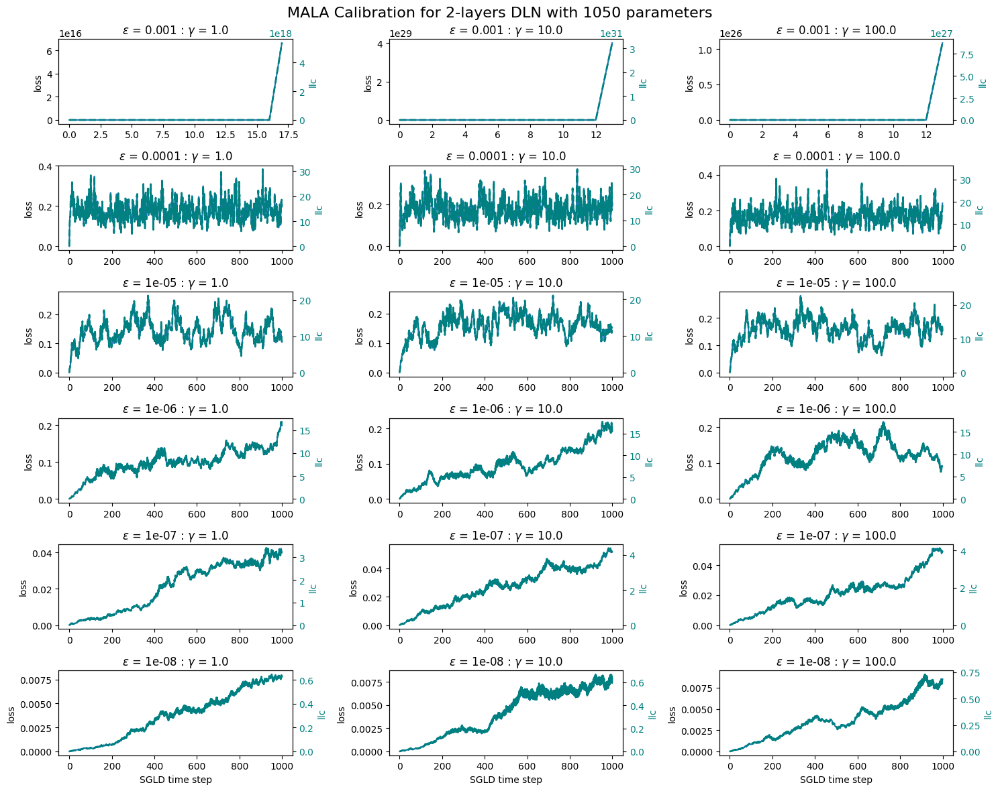

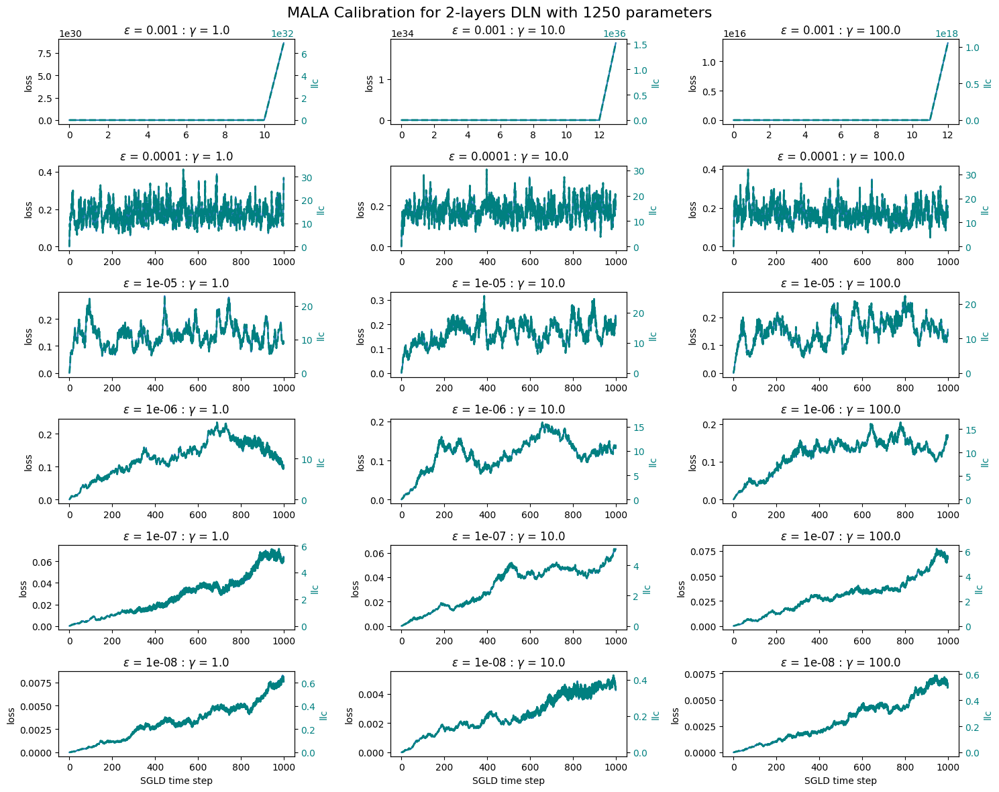

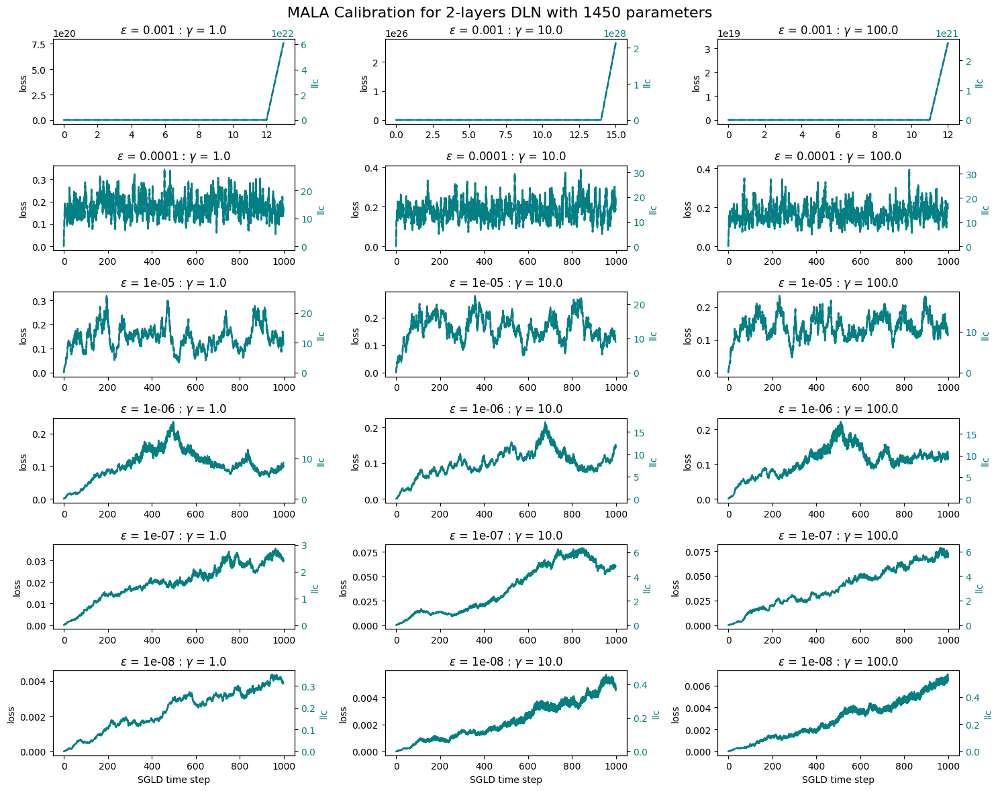

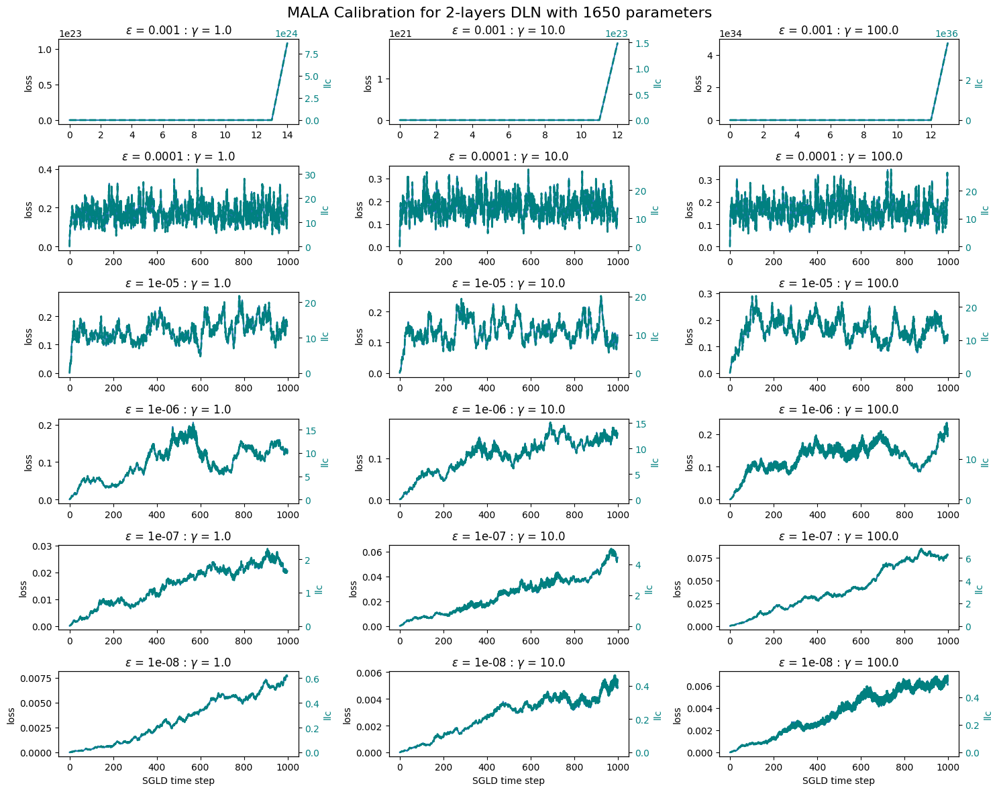

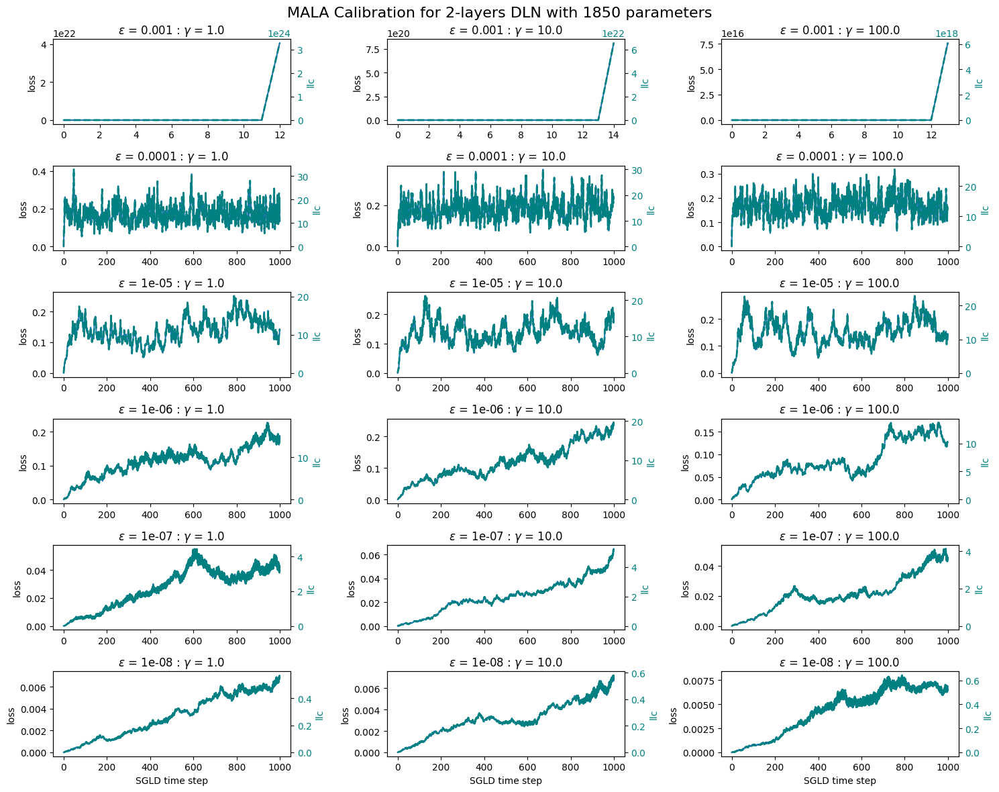

In [145]:
plt.rcParams["figure.figsize"] = (
    15,
    12,
)  # note: this cell may need to be re-run after creating a plot to take effect
for i in range(len(all_calib_results)):
    results = all_calib_results[i]
    plot_sweep_single_model(results, EPSILONS, GAMMAS, title=f"MALA Calibration for 2-layers DLN with {count_parameters(models[i])} parameters")

In [146]:
EPSILONS = [1e-3, 1e-4, 1e-5, 1e-6, 1e-7, 1e-8]
GAMMAS = [1.0, 10.0, 100.0]
NUM_CHAINS = 10
NUM_DRAWS = 500
all_calib_results = []

for i in range(len(hidden_layer_sizes)):
    model = models[i]
    trainloader = train_loader
    criterion = nn.MSELoss()
    calib_results = {}
    print(f'Running MALA calibration for DLN Model with {count_parameters(model)} parameters')


    def estimate_mala_sweeper(model):
        for epsilon in EPSILONS:
            for gamma in GAMMAS:
                mala_estimator = MalaAcceptanceRate(
                    num_chains=NUM_CHAINS,
                    num_draws=NUM_DRAWS,
                    temperature=optimal_temperature(trainloader),
                    learning_rate=epsilon,
                    device=device,
                )

                result = estimate_learning_coeff_with_summary(
                    model,
                    trainloader,
                    criterion=criterion,
                    optimizer_kwargs=dict(
                        lr=epsilon, localization=gamma, temperature=optimal_temperature(trainloader)
                    ),
                    sampling_method=SGLD,
                    num_chains=NUM_CHAINS,
                    num_draws=NUM_DRAWS,
                    callbacks=[mala_estimator],
                    verbose=False,
                    online=True,
                )
                mala_acceptance_rate_mean = mala_estimator.sample()["mala_accept/mean"]
                calib_results[(epsilon, gamma)] = result
                print(
                    f"epsilon {epsilon}, gamma {gamma}, mala rate: {mala_acceptance_rate_mean}"
                )

    estimate_mala_sweeper(model)
    all_calib_results.append(calib_results)

torch.save(all_calib_results, rlcts_path + 'mdraws_all_calib_results.pt')

Running MALA calibration for DLN Model with 50 parameters
epsilon 0.001, gamma 1.0, mala rate: nan
epsilon 0.001, gamma 10.0, mala rate: nan
epsilon 0.001, gamma 100.0, mala rate: nan
epsilon 0.0001, gamma 1.0, mala rate: 0.6386580467224121
epsilon 0.0001, gamma 10.0, mala rate: 0.6377182602882385
epsilon 0.0001, gamma 100.0, mala rate: 0.6316651105880737
epsilon 1e-05, gamma 1.0, mala rate: 0.7752573490142822
epsilon 1e-05, gamma 10.0, mala rate: 0.7483648061752319
epsilon 1e-05, gamma 100.0, mala rate: 0.7609987258911133
epsilon 1e-06, gamma 1.0, mala rate: 0.886254608631134
epsilon 1e-06, gamma 10.0, mala rate: 0.8592490553855896
epsilon 1e-06, gamma 100.0, mala rate: 0.8619487881660461
epsilon 1e-07, gamma 1.0, mala rate: 0.9662901759147644
epsilon 1e-07, gamma 10.0, mala rate: 0.9673040509223938
epsilon 1e-07, gamma 100.0, mala rate: 0.9540610313415527
epsilon 1e-08, gamma 1.0, mala rate: 0.9947527647018433
epsilon 1e-08, gamma 10.0, mala rate: 0.9942125678062439
epsilon 1e-08, ga

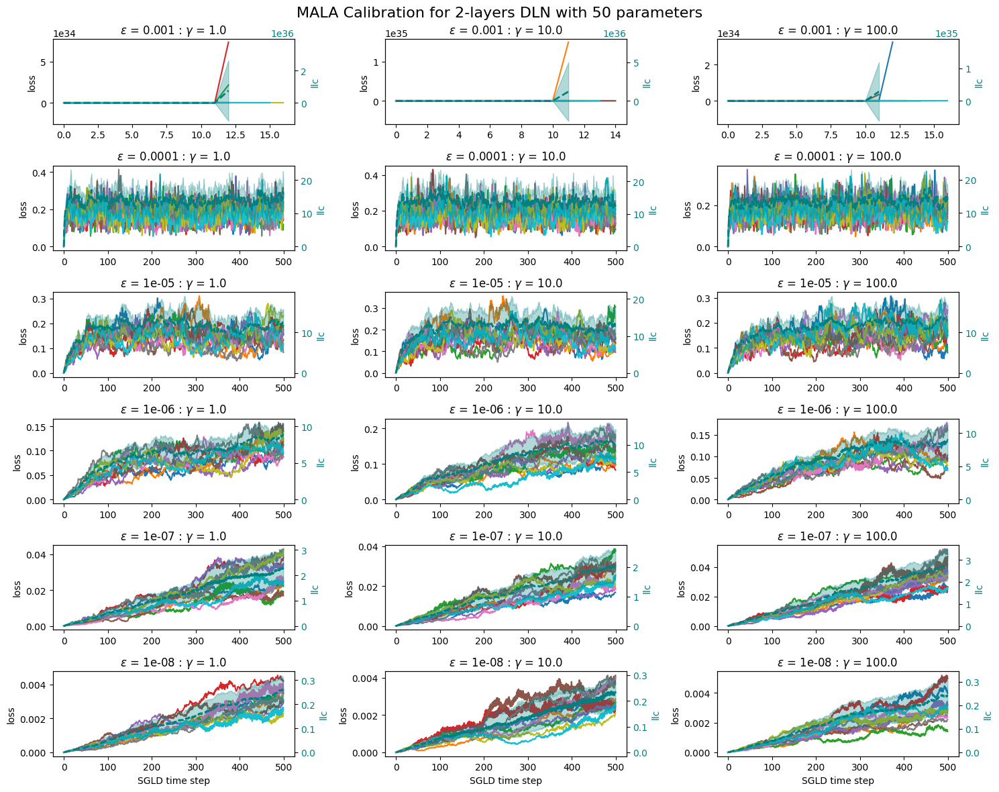

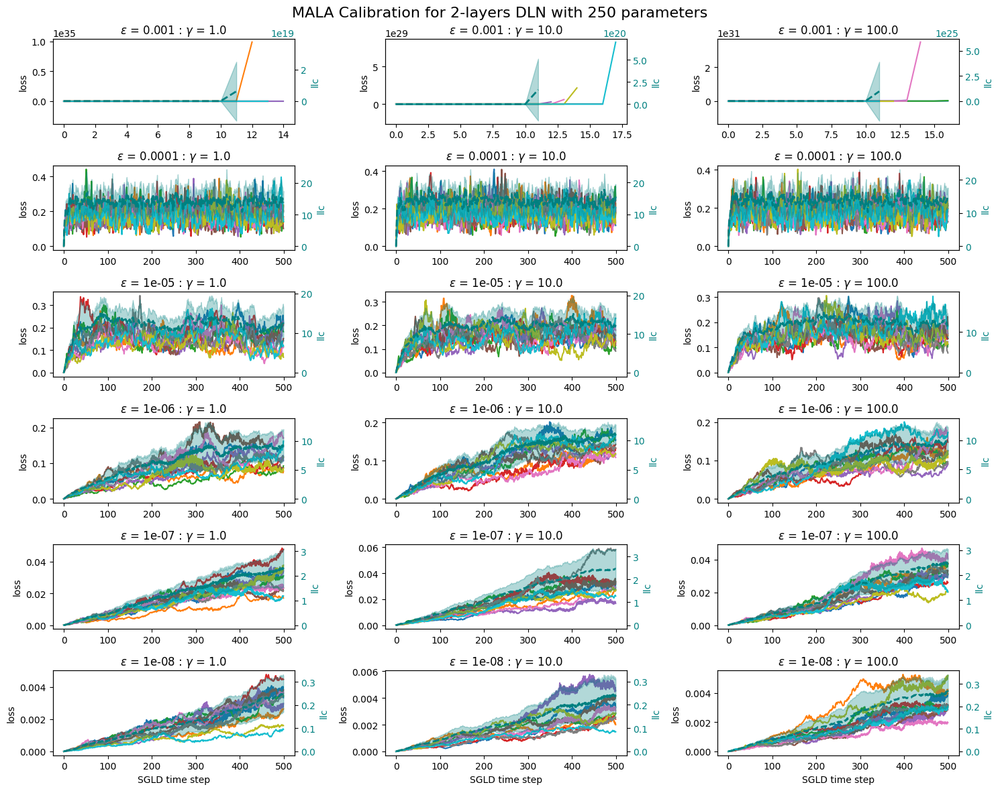

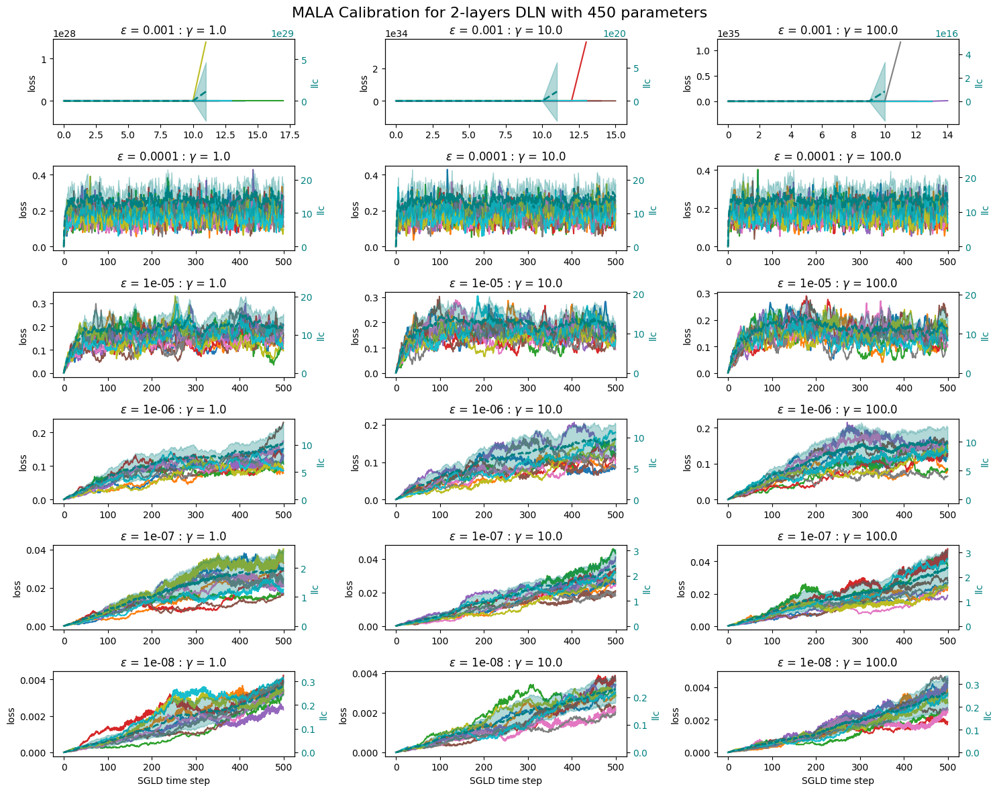

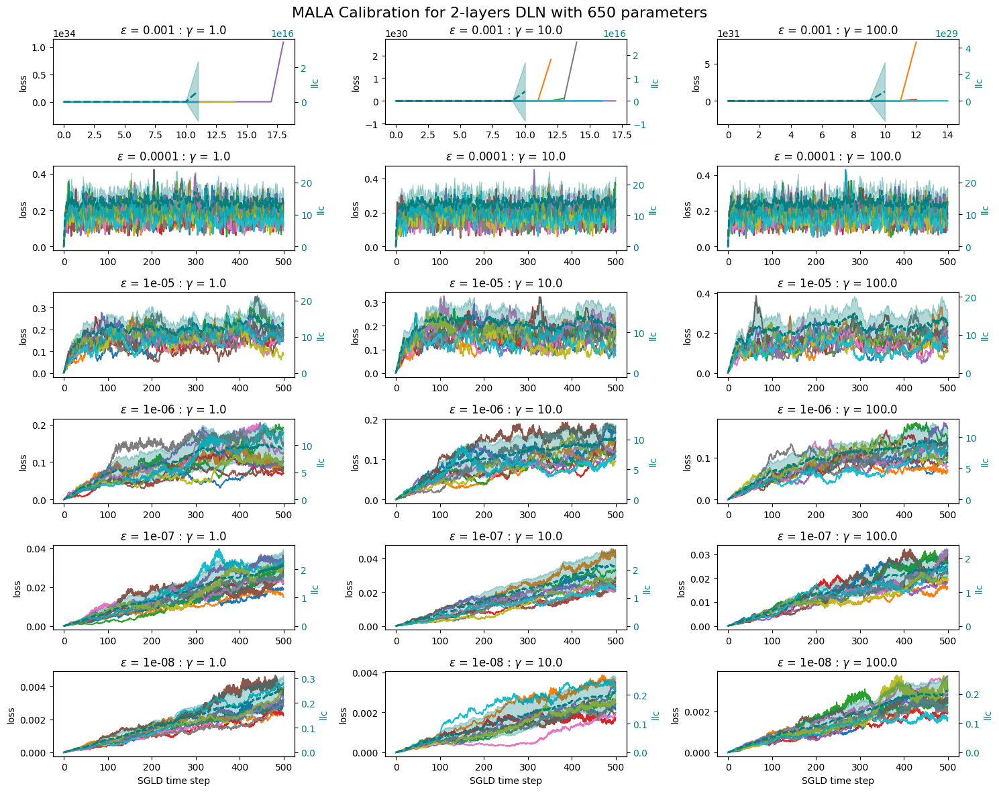

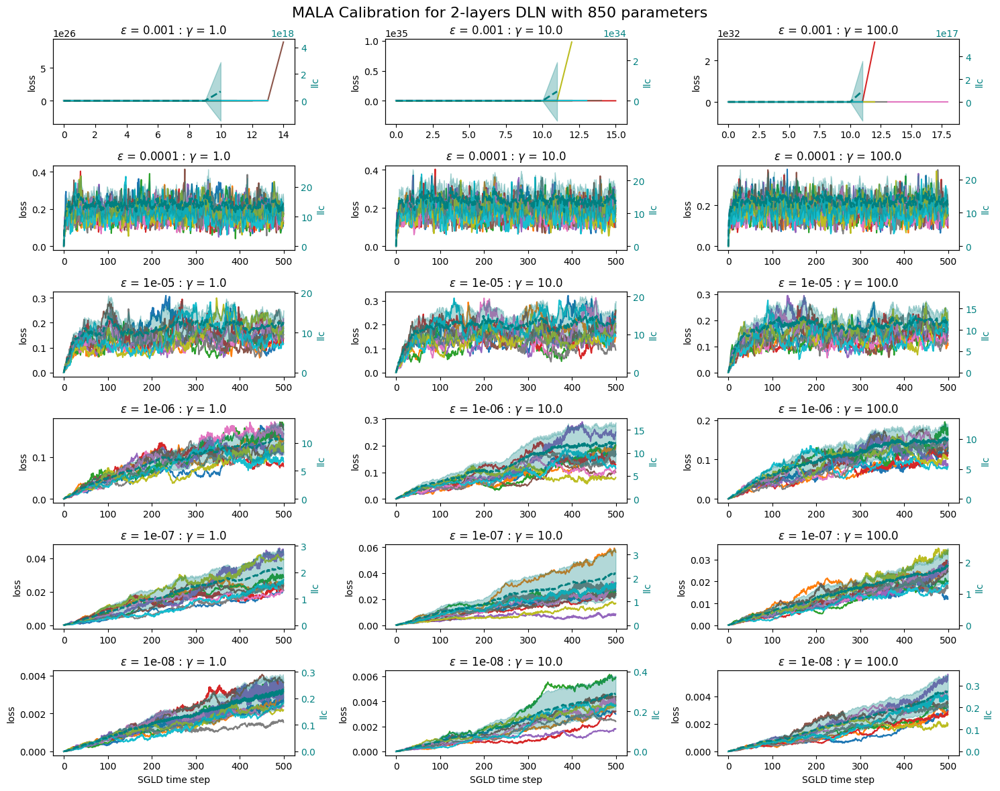

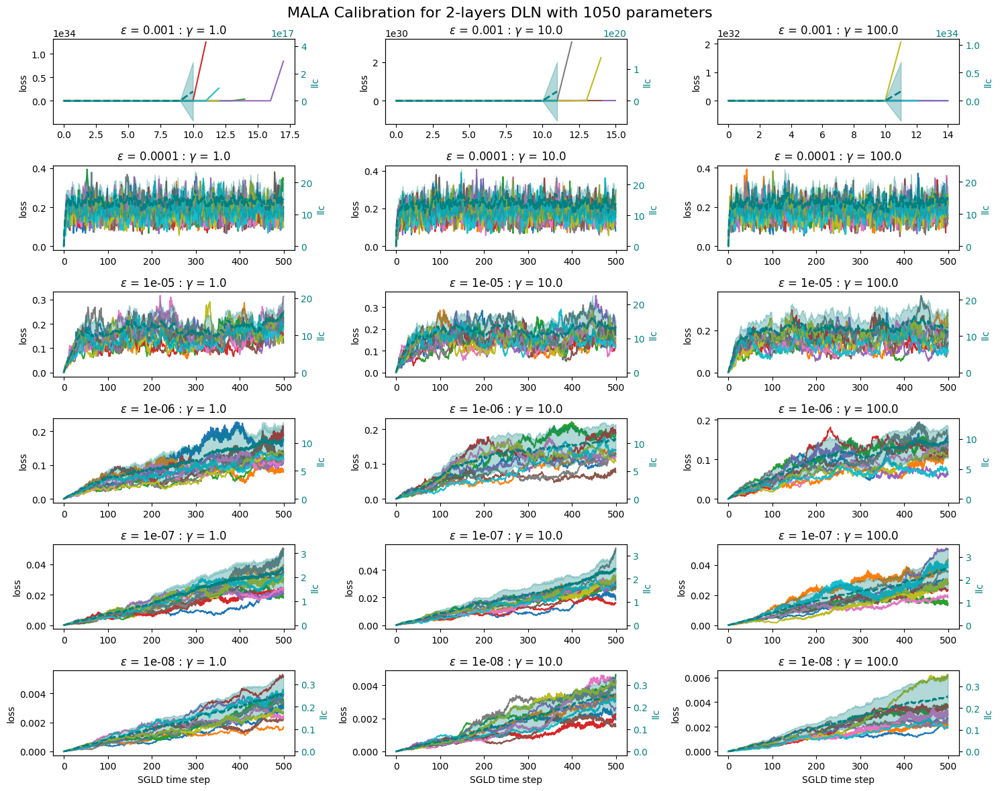

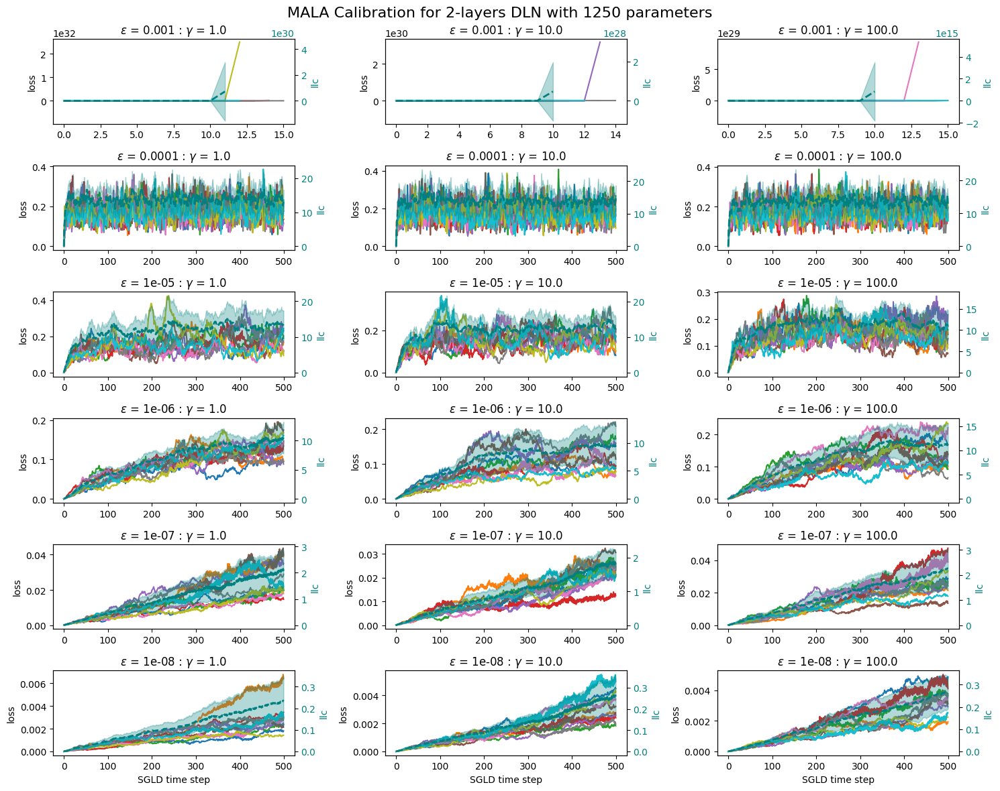

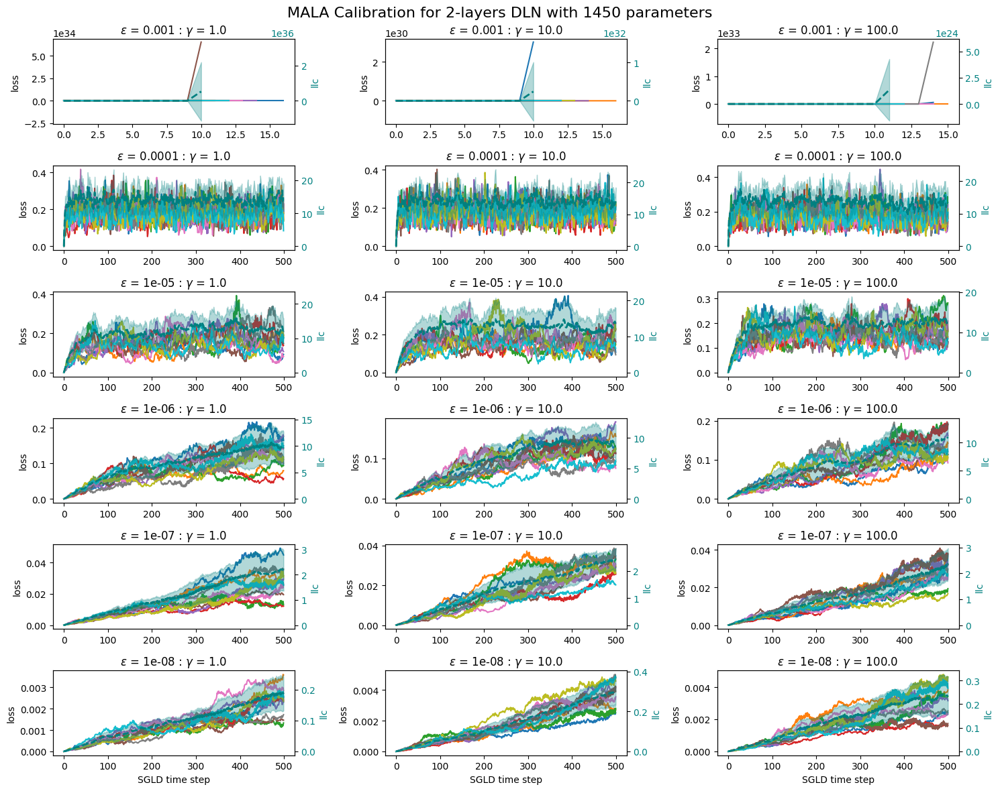

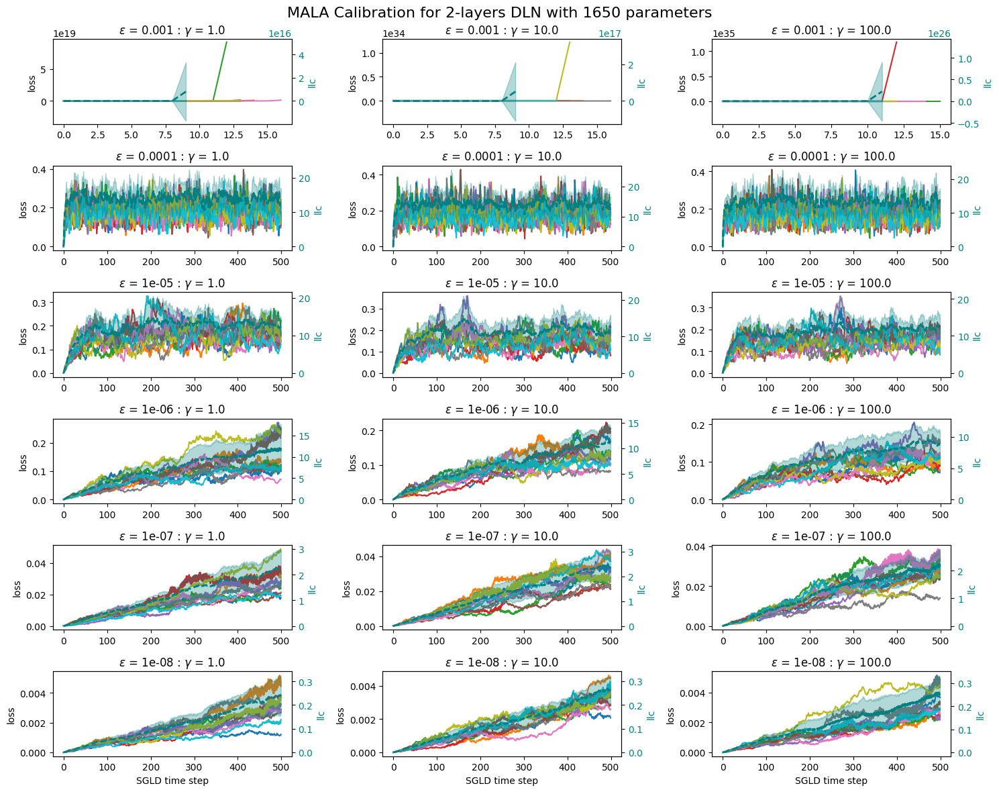

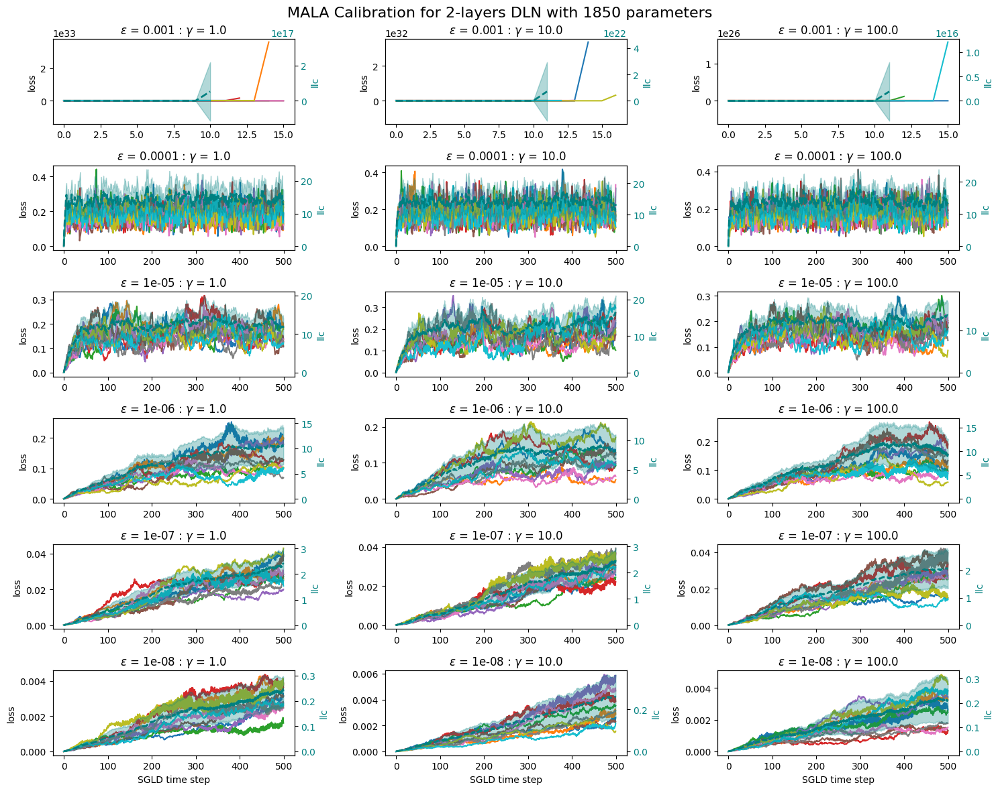

In [147]:
plt.rcParams["figure.figsize"] = (
    15,
    12,
)  # note: this cell may need to be re-run after creating a plot to take effect
for i in range(len(all_calib_results)):
    results = all_calib_results[i]
    plot_sweep_single_model(results, EPSILONS, GAMMAS, title=f"MALA Calibration for 2-layers DLN with {count_parameters(models[i])} parameters")

In [148]:
EPSILONS = [1e-3, 1e-4, 1e-5, 1e-6, 1e-7, 1e-8]
GAMMAS = [1.0, 10.0, 100.0]
NUM_CHAINS = 10
NUM_DRAWS = 1000
all_calib_results = []

for i in range(len(hidden_layer_sizes)):
    model = models[i]
    trainloader = train_loader
    criterion = nn.MSELoss()
    calib_results = {}
    print(f'Running MALA calibration for DLN Model with {count_parameters(model)} parameters')


    def estimate_mala_sweeper(model):
        for epsilon in EPSILONS:
            for gamma in GAMMAS:
                mala_estimator = MalaAcceptanceRate(
                    num_chains=NUM_CHAINS,
                    num_draws=NUM_DRAWS,
                    temperature=optimal_temperature(trainloader),
                    learning_rate=epsilon,
                    device=device,
                )

                result = estimate_learning_coeff_with_summary(
                    model,
                    trainloader,
                    criterion=criterion,
                    optimizer_kwargs=dict(
                        lr=epsilon, localization=gamma, temperature=optimal_temperature(trainloader)
                    ),
                    sampling_method=SGLD,
                    num_chains=NUM_CHAINS,
                    num_draws=NUM_DRAWS,
                    callbacks=[mala_estimator],
                    verbose=False,
                    online=True,
                )
                mala_acceptance_rate_mean = mala_estimator.sample()["mala_accept/mean"]
                calib_results[(epsilon, gamma)] = result
                print(
                    f"epsilon {epsilon}, gamma {gamma}, mala rate: {mala_acceptance_rate_mean}"
                )

    estimate_mala_sweeper(model)
    all_calib_results.append(calib_results)

torch.save(all_calib_results, rlcts_path + 'mdraws_all_calib_results.pt')

Running MALA calibration for DLN Model with 50 parameters
epsilon 0.001, gamma 1.0, mala rate: nan
epsilon 0.001, gamma 10.0, mala rate: nan
epsilon 0.001, gamma 100.0, mala rate: nan
epsilon 0.0001, gamma 1.0, mala rate: 0.6373869180679321
epsilon 0.0001, gamma 10.0, mala rate: 0.634645402431488
epsilon 0.0001, gamma 100.0, mala rate: 0.630398154258728
epsilon 1e-05, gamma 1.0, mala rate: 0.7426645159721375
epsilon 1e-05, gamma 10.0, mala rate: 0.7331229448318481
epsilon 1e-05, gamma 100.0, mala rate: 0.7621461153030396
epsilon 1e-06, gamma 1.0, mala rate: 0.8169829845428467
epsilon 1e-06, gamma 10.0, mala rate: 0.8538269996643066
epsilon 1e-06, gamma 100.0, mala rate: 0.8547507524490356
epsilon 1e-07, gamma 1.0, mala rate: 0.9391224980354309
epsilon 1e-07, gamma 10.0, mala rate: 0.9541079998016357
epsilon 1e-07, gamma 100.0, mala rate: 0.9302202463150024
epsilon 1e-08, gamma 1.0, mala rate: 0.9939939975738525
epsilon 1e-08, gamma 10.0, mala rate: 0.9938954710960388
epsilon 1e-08, gam

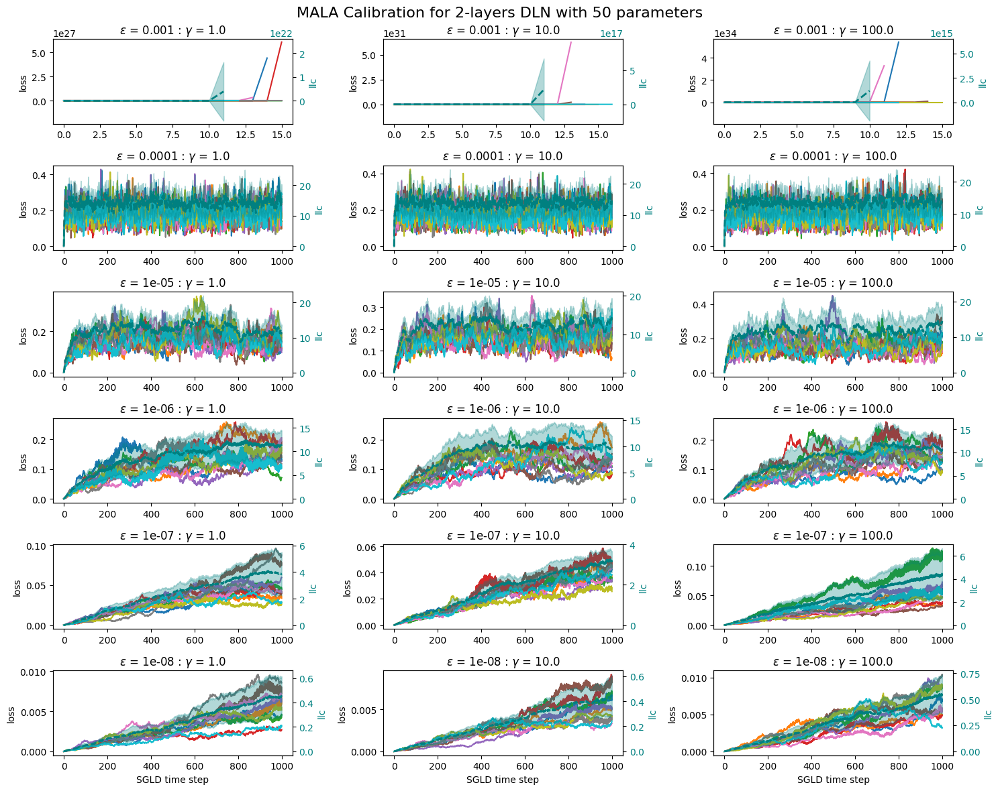

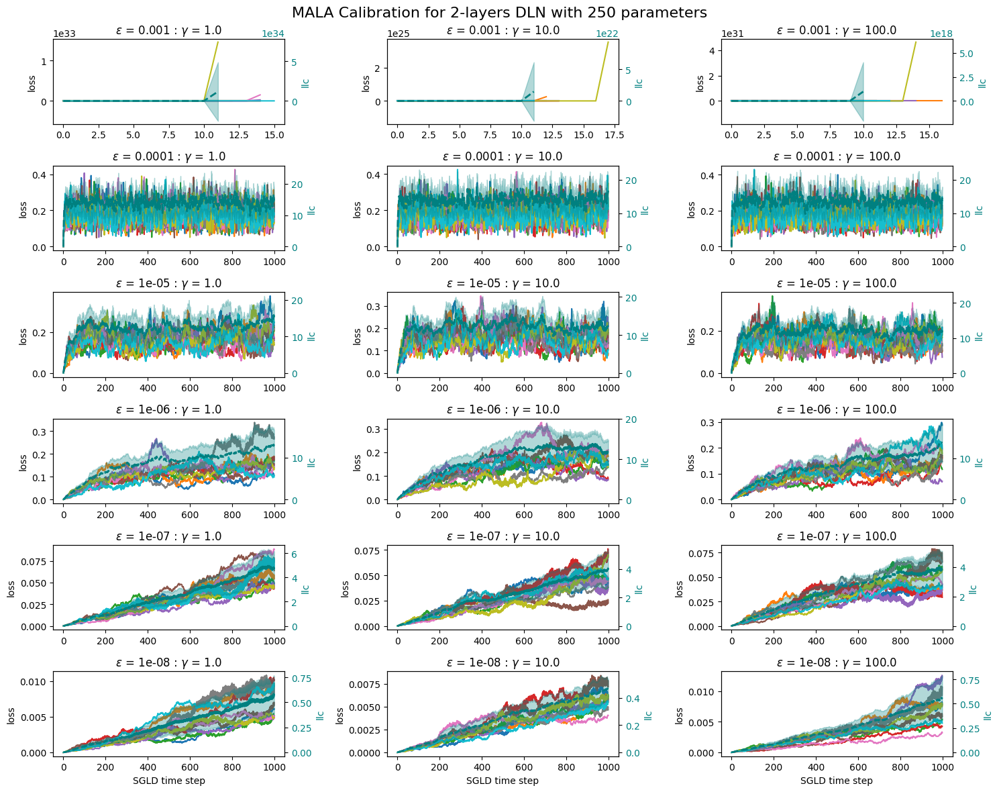

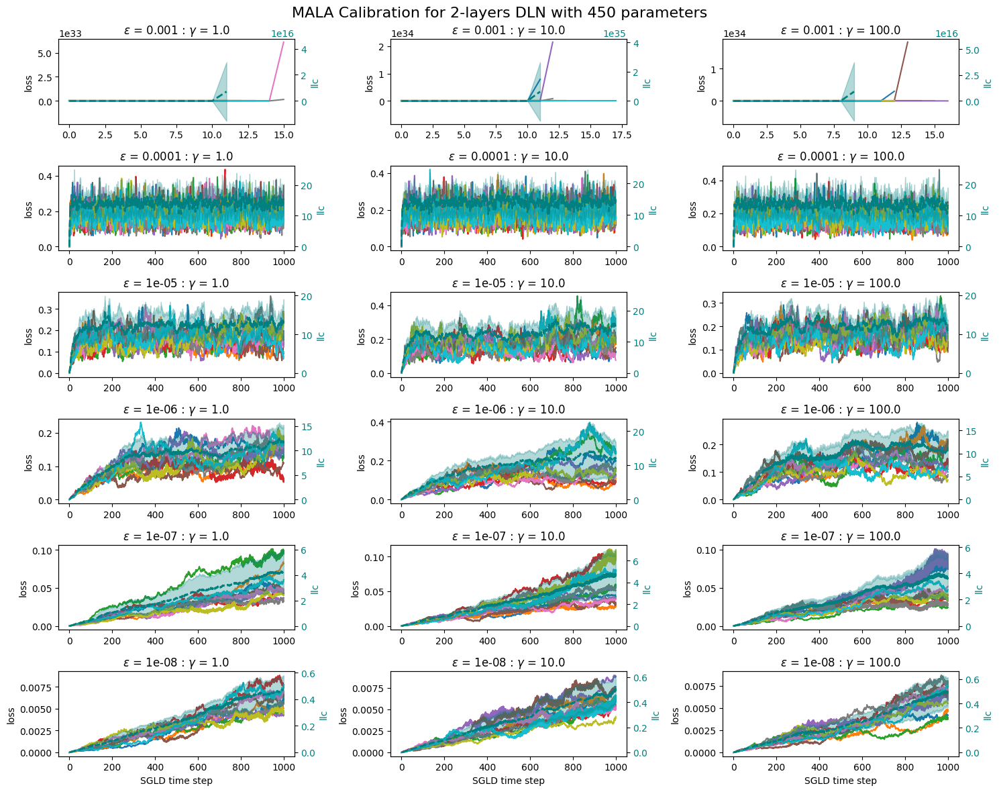

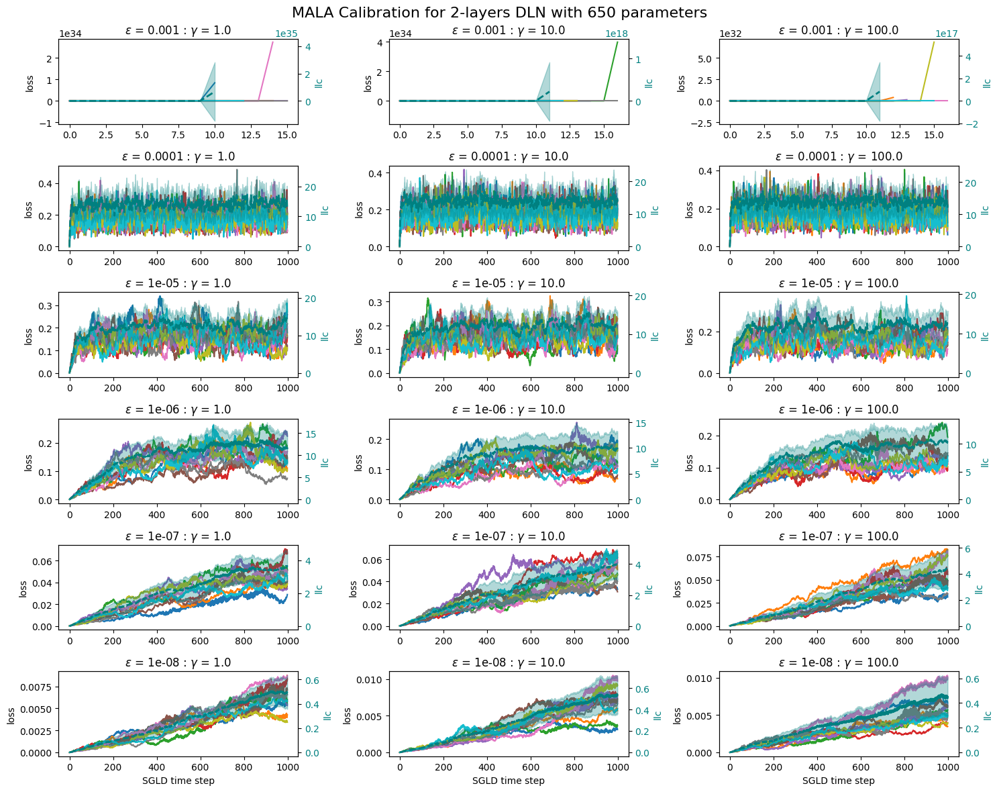

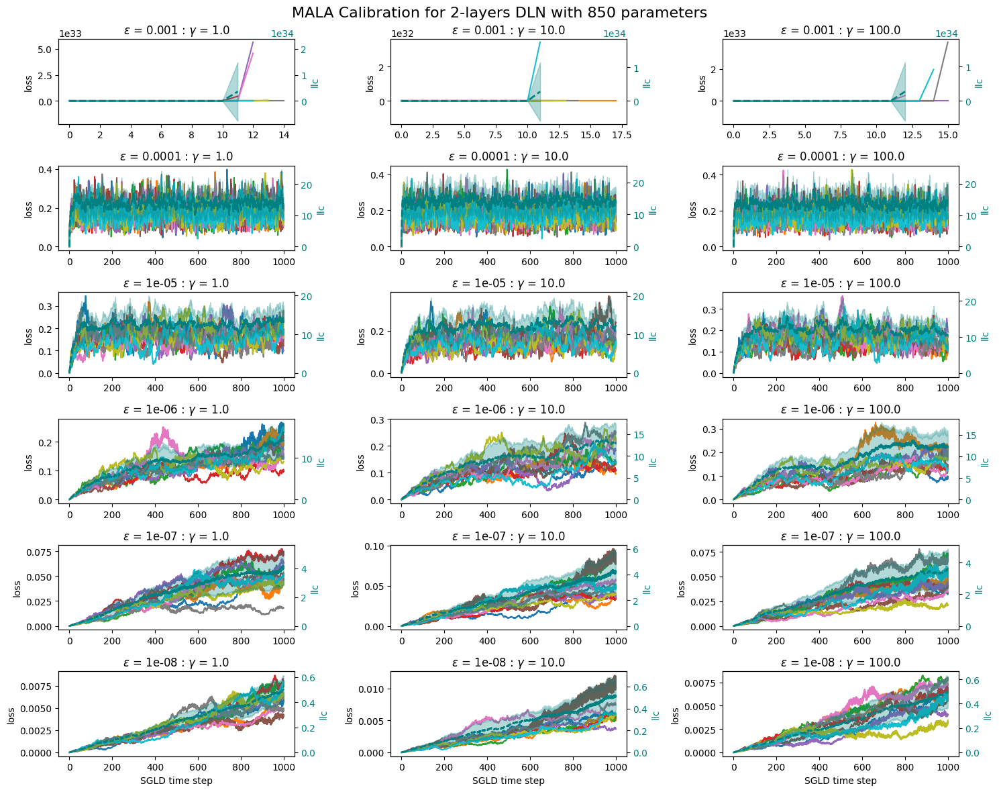

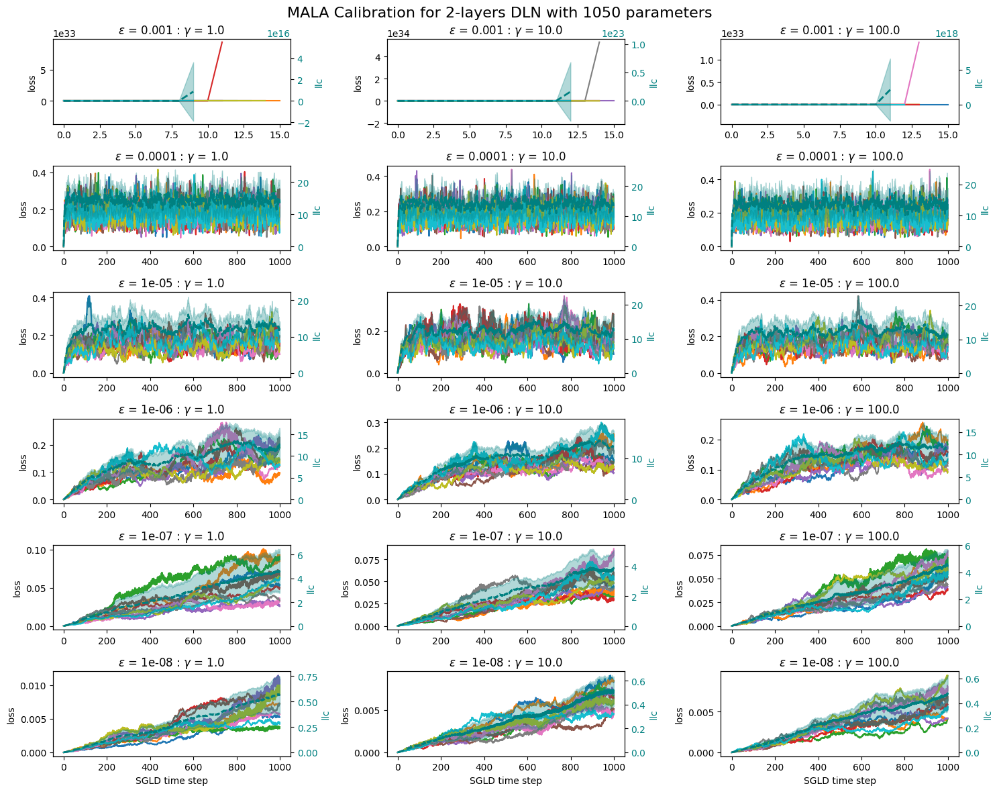

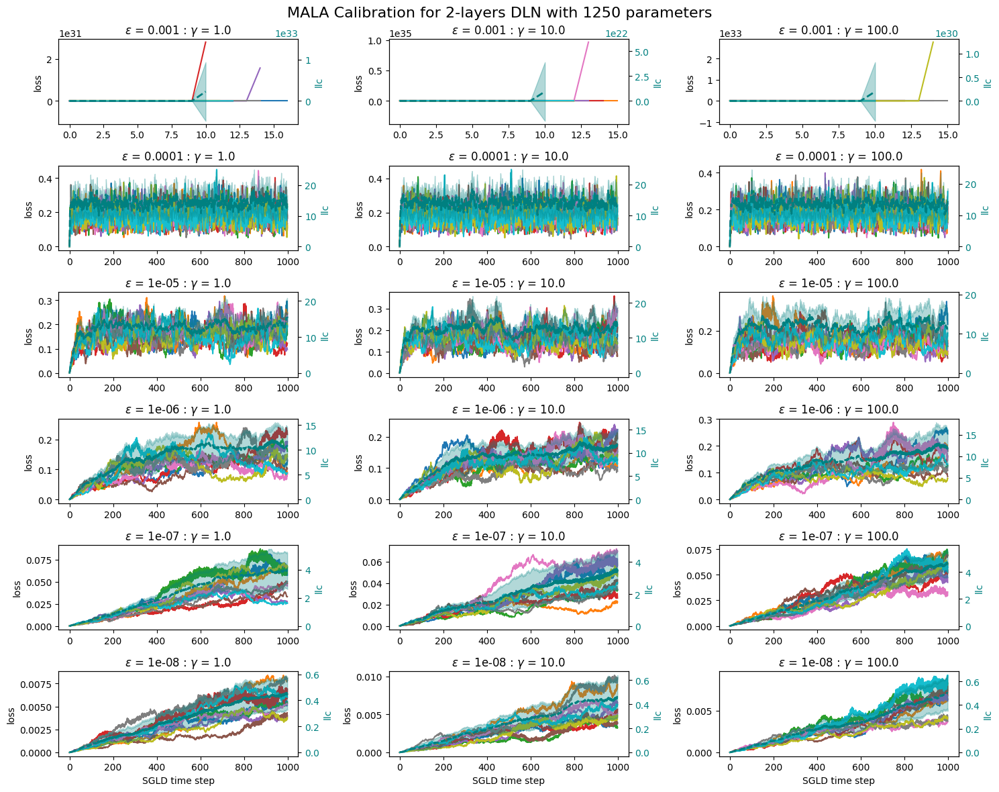

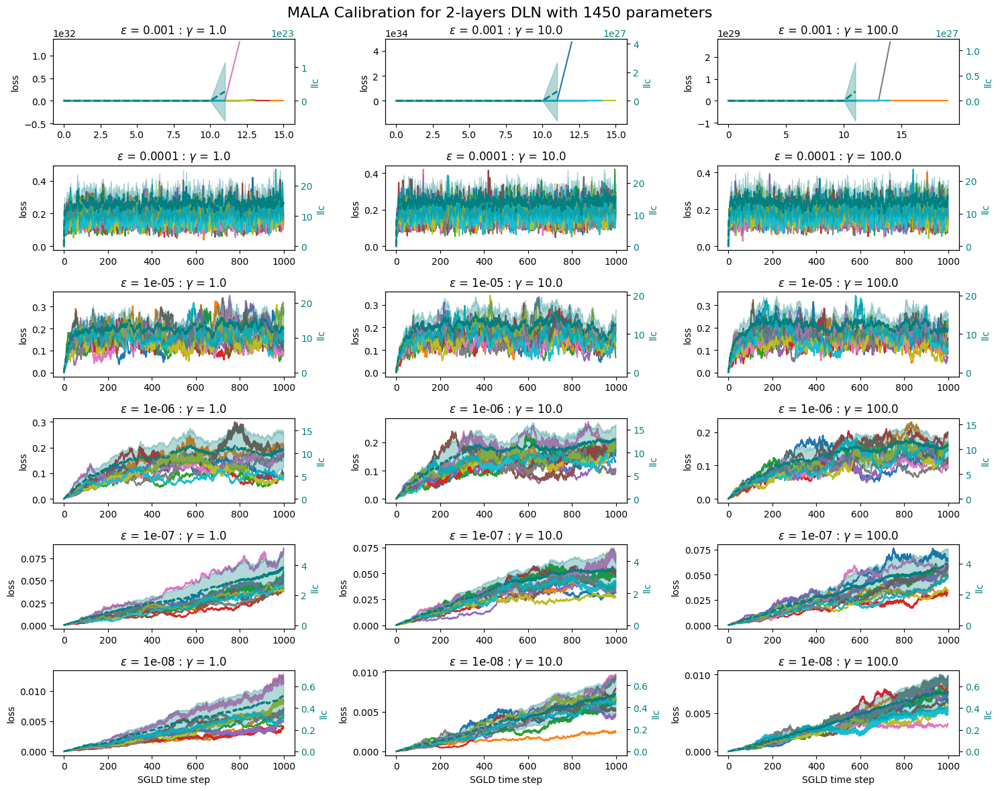

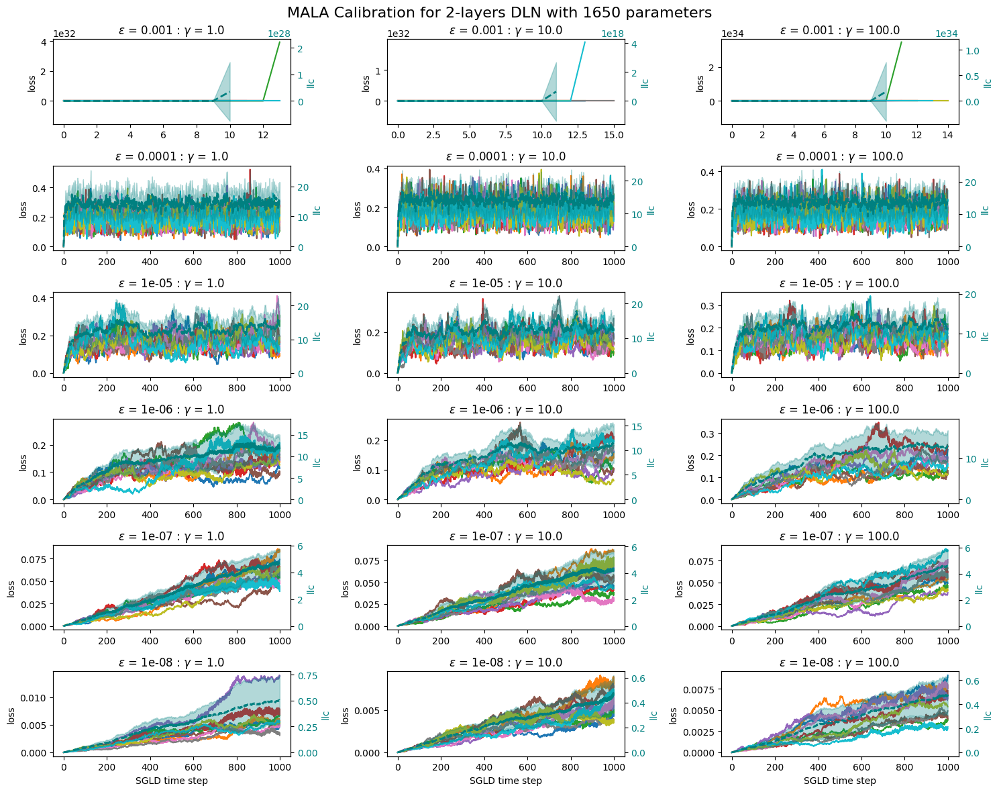

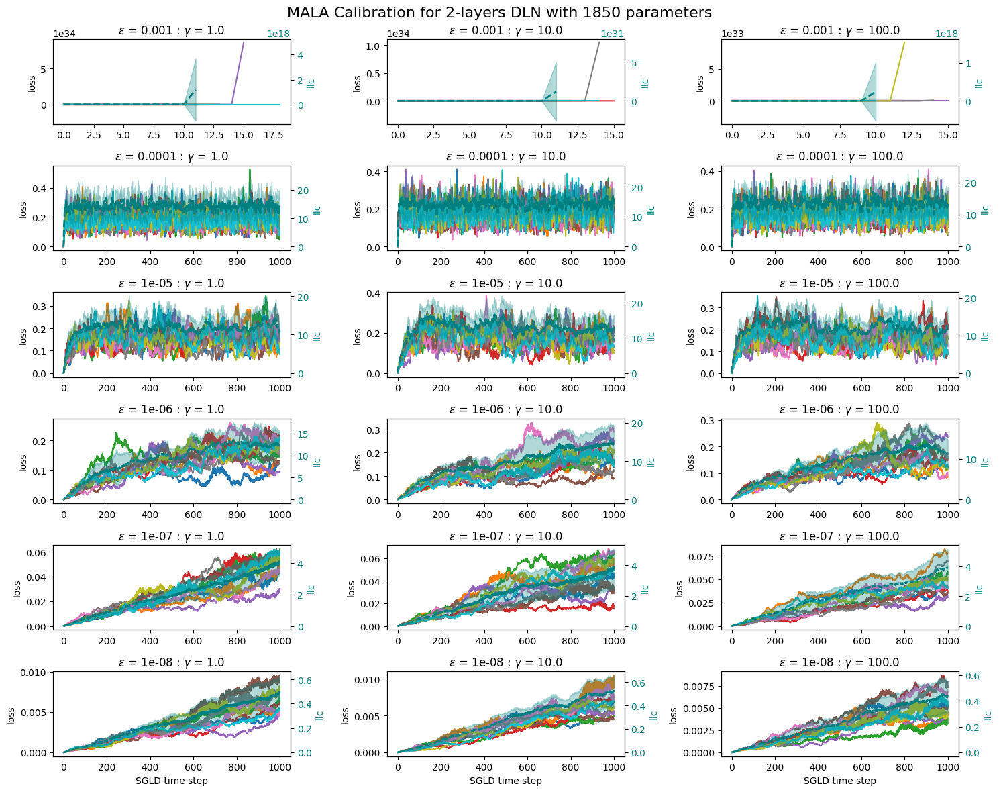

In [149]:
plt.rcParams["figure.figsize"] = (
    15,
    12,
)  # note: this cell may need to be re-run after creating a plot to take effect
for i in range(len(all_calib_results)):
    results = all_calib_results[i]
    plot_sweep_single_model(results, EPSILONS, GAMMAS, title=f"MALA Calibration for 2-layers DLN with {count_parameters(models[i])} parameters")